In [29]:
import json
import time
import pandas as pd
from collections import Counter
import torch

import pandas as pd
import numpy as np
import nltk
import string
import re
import emoji
import torch
import json
import time
import numpy as np

from sklearn.utils import shuffle
from gensim.models import Word2Vec
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import train_test_split

from sklearn.feature_extraction.text import CountVectorizer

In [30]:
from __future__ import unicode_literals, print_function, division
from io import open
import glob
import os

def findFiles(path): return glob.glob(path)

print(findFiles('data/names/*.txt'))

import unicodedata
import string

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

torch.manual_seed(1)

import matplotlib.pyplot as plt  
import seaborn as seabornInstance 
from sklearn.model_selection import train_test_split 
from sklearn.linear_model import LinearRegression
from sklearn import metrics
%matplotlib inline
import json
import datetime


from scipy.cluster.hierarchy import dendrogram, linkage

from sklearn.cluster import AgglomerativeClustering
#import scipy.cluster.hierarchy as sch

#import April12.ipynb
#%store -r icd_grouped 
import statsmodels.api as sm
from patsy import dmatrices 

# model selection
from sklearn.model_selection import train_test_split
from sklearn.feature_selection import SelectFromModel
from sklearn.linear_model import LassoCV

import seaborn



[]


In [31]:
# Basic data files and paths
TOP_100_PATH = '../data/popular_100_memes.csv'
TOP_100 = pd.read_csv(TOP_100_PATH, encoding = "ISO-8859-1")
DATA_PATH = '../data/memes/'

STATS_PATH = '../data/statistics.json'  #statistics.json
with open(STATS_PATH, 'r') as f:
    STATS = json.load(f)
print(TOP_100.head())

          ID                   Name  \
0  112126428   Distracted Boyfriend   
1     438680  Batman Slapping Robin   
2   87743020            Two Buttons   
3  181913649    Drake Hotline Bling   
4      61579    One Does Not Simply   

                                     Alternate Names  
0  distracted bf, guy checking out another girl, ...  
1                                                NaN  
2  2 red buttons, choice button, which button, da...  
3  drakeposting, drakepost, drake hotline approve...  
4  one does not simply walk into morder, lord of ...  


In [32]:
DATA_PATH

'../data/memes/'

In [33]:
memes_count = Counter(STATS['memes'])
print(len(STATS['memes']))
for f, c in memes_count.most_common():
    print(f)
    #print(f, c)

99
Bad-Luck-Brian.json
One-Does-Not-Simply.json
Philosoraptor.json
Boardroom-Meeting-Suggestion.json
Futurama-Fry.json
First-World-Problems.json
The-Most-Interesting-Man-In-The-World.json
Batman-Slapping-Robin.json
Bad-Pun-Dog.json
X-X-Everywhere.json
Expanding-Brain.json
Two-Buttons.json
But-Thats-None-Of-My-Business.json
Ancient-Aliens.json
Creepy-Condescending-Wonka.json
Grumpy-Cat.json
Y-U-No.json
The-Rock-Driving.json
That-Would-Be-Great.json
Waiting-Skeleton.json
Change-My-Mind.json
Leonardo-Dicaprio-Cheers.json
10-Guy.json
Captain-Picard-Facepalm.json
Matrix-Morpheus.json
Third-World-Skeptical-Kid.json
Confession-Bear.json
Am-I-The-Only-One-Around-Here.json
Success-Kid.json
Hide-the-Pain-Harold.json
Roll-Safe-Think-About-It.json
Evil-Toddler.json
Awkward-Moment-Sealion.json
Face-You-Make-Robert-Downey-Jr.json
Mocking-Spongebob.json
Disaster-Girl.json
Blank-Nut-Button.json
Dont-You-Squidward.json
Inhaling-Seagull.json
Back-In-My-Day.json
Grandma-Finds-The-Internet.json
Brace-Your

In [36]:
memes = []
for f, c in memes_count.most_common():
    memes.append(f)
    
selected_memes = memes

def open_data(path):
    with open(path, 'r') as f:
        data = json.load(f)
    return data

memes_data = [open_data(DATA_PATH + meme) for meme in selected_memes]   

In [37]:
# Preprocessing data for modelling
from nltk import sent_tokenize, word_tokenize
from gensim.models import Word2Vec

In [38]:
def parse_text(text):
    text = text.lower().strip()
    return word_tokenize(text)

def parse_blocks(blocks):
    result = []
    for i,b in enumerate(blocks):
        result.append(parse_text(b))
#         if i < len(blocks) - 1:
#             result.extend('|')
    return result

ex = parse_blocks(memes_data[0][0]['boxes'])
print(ex)
model = Word2Vec(ex, min_count=1)
print(model)

[['gets', 'covid', '19', 'and', 'recovers'], ['dies', 'from', 'complications', 'related', 'to', 'the', 'common', 'cold', '.']]
Word2Vec(vocab=14, size=100, alpha=0.025)


# Most Frequent Words

In [39]:
#each format is a element in array 
#then concetenate all box strings of a meme format, amke it into a single stringle 

allwords_memeformat = []
#onestring_memeformat = ''

for i in range(len(memes_data)):
    eachformat_string = ''
    
    for ele in memes_data[i]:
        print("This is ele: " + str(ele))
        box = ele['boxes']
        
        string = ' '.join(box)
        eachformat_string = eachformat_string +  string
    
    allwords_memeformat.append(eachformat_string)

This is ele: {'url': 'https://i.imgflip.com/3y4g0q.jpg', 'post': 'https://imgflip.com/i/3y4g0q', 'metadata': {'views': '209', 'img-votes': '2', 'title': 'Bad Luck Brian', 'author': 'david.leitz'}, 'boxes': ['GETS COVID 19 AND RECOVERS', 'DIES FROM COMPLICATIONS RELATED TO THE COMMON COLD.']}
This is ele: {'url': 'https://i.imgflip.com/3x5wby.jpg', 'post': 'https://imgflip.com/i/3x5wby', 'metadata': {'views': '2,134', 'img-votes': '27', 'title': 'Bad Luck Brian', 'author': 'AranZag234'}, 'boxes': ['PLANS TO START A SELF EMPLOYED JOB AT HOME', 'FAILS AT THE JOB INTERVIEW']}
This is ele: {'url': 'https://i.imgflip.com/3yhrz9.jpg', 'post': 'https://imgflip.com/i/3yhrz9', 'metadata': {'views': '164', 'img-votes': '3', 'title': 'Bad Luck Brian', 'author': 'dannyhogan200'}, 'boxes': ['PUTS HOT POCKET IN MICROWAVE', 'ARRESTED FOR ANIMAL CRUELTY']}
This is ele: {'url': 'https://i.imgflip.com/3yc99u.jpg', 'post': 'https://imgflip.com/i/3yc99u', 'metadata': {'views': '245', 'img-votes': '2', 'tit

This is ele: {'url': 'https://i.imgflip.com/2n2q45.jpg', 'post': 'https://imgflip.com/i/2n2q45', 'metadata': {'views': '678', 'img-votes': '8', 'title': 'Bad Luck Brian', 'author': 'TimidDeer'}, 'boxes': ['GETS REJECTED BY', 'OVERLY ATTACHED GIRLFRIEND']}
This is ele: {'url': 'https://i.imgflip.com/se7am.jpg', 'post': 'https://imgflip.com/i/se7am', 'metadata': {'views': '6,942', 'img-votes': '100', 'title': 'Bad Luck Brian', 'author': None}, 'boxes': ['FINISHES THE HARDEST MATH EQUATION EVER DOESNT SHOW HIS WORK']}
This is ele: {'url': 'https://i.imgflip.com/gt6py.jpg', 'post': 'https://imgflip.com/i/gt6py', 'metadata': {'views': '19,216', 'img-votes': '123', 'title': 'Viral Meme', 'author': 'UltraJordan'}, 'boxes': ['POSTS MEME, NO UPVOTES SOMEONE COPIES, GOES VIRAL']}
This is ele: {'url': 'https://i.imgflip.com/2hkm7u.jpg', 'post': 'https://imgflip.com/i/2hkm7u', 'metadata': {'views': '433', 'img-votes': '11', 'title': 'Bad Luck Brian camouflage', 'author': 'Juggernaut2870'}, 'boxes'

This is ele: {'url': 'https://i.imgflip.com/1qrclj.jpg', 'post': 'https://imgflip.com/i/1qrclj', 'metadata': {'views': '401', 'img-votes': '18', 'title': 'Bad Luck Brian', 'author': None}, 'boxes': ['LAST MAN ON EARTH', 'EVERY WOMAN COMMITS SUICIDE']}
This is ele: {'url': 'https://i.imgflip.com/197ik3.jpg', 'post': 'https://imgflip.com/i/197ik3', 'metadata': {'views': '2,703', 'img-votes': '25', 'title': 'Bad Luck Brian', 'author': 'Tenacious'}, 'boxes': ['ATTEMPTS WATER POLO', 'HORSE DROWNS']}
This is ele: {'url': 'https://i.imgflip.com/3379f3.jpg', 'post': 'https://imgflip.com/i/3379f3', 'metadata': {'views': '235', 'img-votes': '1', 'title': 'Bad Luck Brian', 'author': 'SheerForce'}, 'boxes': ["WELL... SUCKS TO BE YOU, DOESN'T IT..."]}
This is ele: {'url': 'https://i.imgflip.com/warmw.jpg', 'post': 'https://imgflip.com/i/warmw', 'metadata': {'views': '1,430', 'img-votes': '36', 'title': "He didn't laugh last...", 'author': None}, 'boxes': ['MAKES FUN OF SIDEWALK ARTIST CHALK NORRIS'

This is ele: {'url': 'https://i.imgflip.com/2cnrz3.jpg', 'post': 'https://imgflip.com/i/2cnrz3', 'metadata': {'views': '260', 'img-votes': '4', 'title': 'Bad Luck Brian', 'author': None}, 'boxes': ['SEES 2 GUYS SPARRING AND CALLS THEM PUSSIES', 'BRUCE LEE & CHUCK NORRIS']}
This is ele: {'url': 'https://i.imgflip.com/2crpdq.jpg', 'post': 'https://imgflip.com/i/2crpdq', 'metadata': {'views': '163', 'img-votes': '3', 'title': 'Bad Luck Brian', 'author': None}, 'boxes': ['GOES TO A PSYCHIATRIST TO HELP WITH HIS DEPRESSION', 'GETS TOLD TO JUMP IN FRONT OF TRAFFIC']}
This is ele: {'url': 'https://i.imgflip.com/1tmavs.jpg', 'post': 'https://imgflip.com/i/1tmavs', 'metadata': {'views': '302', 'img-votes': '7', 'title': 'Bad Luck Brian', 'author': None}, 'boxes': ['Grandma is declining quickly. Tells her he loves her and she has always been kind to him. She tells him, "Sweet heart,\nI\'m always nice to people who are mentally challenged."']}
This is ele: {'url': 'https://i.imgflip.com/2ky5xc.jp

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




This is ele: {'url': 'https://i.imgflip.com/do2ha.jpg', 'post': 'https://imgflip.com/i/do2ha', 'metadata': {'views': '1,544', 'img-votes': '3', 'title': 'One Does Not Simply', 'author': 'nechakotess'}, 'boxes': ['OBJECTIVITY IS NOT ONLY IMPOSSIBLE IT IS UNDESIRABLE']}
This is ele: {'url': 'https://i.imgflip.com/bii36.jpg', 'post': 'https://imgflip.com/i/bii36', 'metadata': {'views': '1,197', 'img-votes': '4', 'title': 'One Does Not Simply', 'author': 'killeasy'}, 'boxes': ["SEE THAT'S THAT BULLSHIT"]}
This is ele: {'url': 'https://i.imgflip.com/cvrvm.jpg', 'post': 'https://imgflip.com/i/cvrvm', 'metadata': {'views': '403', 'img-votes': '2', 'title': 'One Does Not Simply', 'author': 'PatrickHaynes'}, 'boxes': ['ONE DOES SIMPLY BECOME A DUMBASS']}
This is ele: {'url': 'https://i.imgflip.com/yp5fh.jpg', 'post': 'https://imgflip.com/i/yp5fh', 'metadata': {'views': '1,136', 'img-votes': '1', 'title': 'One Does Not Simply', 'author': 'yusufHassan'}, 'boxes': ['CHINA IS FULL WINGS AND WONGS'

This is ele: {'url': 'https://i.imgflip.com/1z4e45.jpg', 'post': 'https://imgflip.com/i/1z4e45', 'metadata': {'views': '192', 'img-votes': '2', 'title': 'One Does Not Simply', 'author': 'sparkykenny'}, 'boxes': ['ONE DOES NOT SIMPLY GO TO SCHOOL ... YOU MUST BRING A GUN WITH YOU']}
This is ele: {'url': 'https://i.imgflip.com/li9j4.jpg', 'post': 'https://imgflip.com/i/li9j4', 'metadata': {'views': '1,177', 'img-votes': '1', 'title': 'One Does Not Simply', 'author': 'okorugaijin'}, 'boxes': ['I AWARD YOU THIS MANY POINTS MAY GOD HAVE MERCY ON YOUR SOUL']}
This is ele: {'url': 'https://i.imgflip.com/2ga5vx.jpg', 'post': 'https://imgflip.com/i/2ga5vx', 'metadata': {'views': '502', 'img-votes': '1', 'title': 'One Does Not Simply', 'author': 'RandallHammer'}, 'boxes': ["ONE SIMPLY DOESN'T GIVE A F*CK ABOUT POLITICAL MEMES"]}
This is ele: {'url': 'https://i.imgflip.com/kfi0j.jpg', 'post': 'https://imgflip.com/i/kfi0j', 'metadata': {'views': '1,212', 'img-votes': 0, 'title': 'If only great mem

This is ele: {'url': 'https://i.imgflip.com/zz1k1.jpg', 'post': 'https://imgflip.com/i/zz1k1', 'metadata': {'views': '2,218', 'img-votes': '2', 'title': 'One Does Not Simply', 'author': 'icucathy'}, 'boxes': ['A TYPE ONE DIABETIC DOES NOT SIMPLY', 'STOP NEEDING INSULIN']}
This is ele: {'url': 'https://i.imgflip.com/1bor5u.jpg', 'post': 'https://imgflip.com/i/1bor5u', 'metadata': {'views': '1,512', 'img-votes': '1', 'title': 'One Does Not Simply', 'author': None}, 'boxes': ["BASS PRO SHOPS JUST BOUGHT CABELA'S FOR $5.5 BILLION!! WHY RUIN A NEBRASKA TRADITION?"]}
This is ele: {'url': 'https://i.imgflip.com/b91t6.jpg', 'post': 'https://imgflip.com/i/b91t6', 'metadata': {'views': '491', 'img-votes': '3', 'title': 'One Does Not Simply', 'author': 'froook77'}, 'boxes': ['ONE DOES NOT SIMPLY POOP IN A PUBLIC RESTROOM']}
This is ele: {'url': 'https://i.imgflip.com/m57q2.jpg', 'post': 'https://imgflip.com/i/m57q2', 'metadata': {'views': '1,664', 'img-votes': '4', 'title': 'One Does Not Simply',

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




This is ele: {'url': 'https://i.imgflip.com/2kcknr.jpg', 'post': 'https://imgflip.com/i/2kcknr', 'metadata': {'views': '64', 'img-votes': 0, 'title': 'Boardroom Meeting Suggestion', 'author': 'juliengari5406'}, 'boxes': ['WERE IN A BUILD BATTLE WHAT DO YOU GUYS HAVE', 'I GOT MATS', 'I GOT SHIELDS', "I'LL LEAVE AND BUSH CAMP"]}
This is ele: {'url': 'https://i.imgflip.com/27fvkn.jpg', 'post': 'https://imgflip.com/i/27fvkn', 'metadata': {'views': '136', 'img-votes': 0, 'title': 'Boardroom Meeting Suggestion', 'author': 'Henchman21'}, 'boxes': ['WE NEED NEW IDEAS FOR THE NEW CALL OF DUTY NEXT YEAR. ANY SUGGETIONS? MAKE IT A MODERN WARFARE 3 SEQUEL! MAKE IT A VIETNAM WAR SHOOTER', "DON'T ADD SUPPLY DROPS."]}
This is ele: {'url': 'https://i.imgflip.com/2bhorb.jpg', 'post': 'https://imgflip.com/i/2bhorb', 'metadata': {'views': '103', 'img-votes': 0, 'title': 'Boardroom Meeting Suggestion', 'author': 'PuteriNurFarzanaMohdHaniff'}, 'boxes': ['WE NEED TO MAKE A PRODUCT! maybe a boat shop', 'i s

This is ele: {'url': 'https://i.imgflip.com/20myji.jpg', 'post': 'https://imgflip.com/i/20myji', 'metadata': {'views': '1,191', 'img-votes': '13', 'title': 'Futurama Fry', 'author': 'apesfollowkoba'}, 'boxes': ['SOME PEOPLE GET HANGRY', 'I GET HORNGRY']}
This is ele: {'url': 'https://i.imgflip.com/14le62.jpg', 'post': 'https://imgflip.com/i/14le62', 'metadata': {'views': '2,251', 'img-votes': '31', 'title': 'Futurama Fry', 'author': 'Jensen2185'}, 'boxes': ["CHIPOTLE? NOT SURE IF THEY'RE TRYING TO POISON ME..."]}
This is ele: {'url': 'https://i.imgflip.com/2vekof.jpg', 'post': 'https://imgflip.com/i/2vekof', 'metadata': {'views': '230', 'img-votes': '2', 'title': 'Futurama Fry', 'author': 'Tinky-Winky'}, 'boxes': ['WHEN YOU GET IN TROUBLE FOR SOMETHING BY YOUR TEACHER', 'AND THEN SOMEONE ELSE DOES THE SAME THING BUT DOESN’T GET IN TROUBLE']}
This is ele: {'url': 'https://i.imgflip.com/2n5b8v.jpg', 'post': 'https://imgflip.com/i/2n5b8v', 'metadata': {'views': '155', 'img-votes': '4', 't

This is ele: {'url': 'https://i.imgflip.com/1eow0z.jpg', 'post': 'https://imgflip.com/i/1eow0z', 'metadata': {'views': '258', 'img-votes': '6', 'title': 'Futurama Fry', 'author': 'dart38'}, 'boxes': ['I GET PAID TO BE NICE AT WORK. NOT SURE WHY MY FRIENDS AND FAMILY EXPECT THAT SHIT FOR FREE.']}
This is ele: {'url': 'https://i.imgflip.com/11uj0d.jpg', 'post': 'https://imgflip.com/i/11uj0d', 'metadata': {'views': '1,905', 'img-votes': '8', 'title': 'Futurama Fry', 'author': 'Kanaloa'}, 'boxes': ["4/20, NOT SURE IF WE'RE CELEBRATING A DAY TO GET HIGH", 'OR HITLERS BIRTHDAY']}
This is ele: {'url': 'https://i.imgflip.com/19fpjh.jpg', 'post': 'https://imgflip.com/i/19fpjh', 'metadata': {'views': '757', 'img-votes': '5', 'title': 'Templates, templates everywhere', 'author': 'InsaneHippo'}, 'boxes': ['IS IT JUST ME, OR', "I DON'T ALWAYS USE THE WRONG TEMPLATE, BUT WHEN I DO..."]}
This is ele: {'url': 'https://i.imgflip.com/2fru4t.jpg', 'post': 'https://imgflip.com/i/2fru4t', 'metadata': {'vie

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




This is ele: {'url': 'https://i.imgflip.com/g90w7.jpg', 'post': 'https://imgflip.com/i/g90w7', 'metadata': {'views': '269', 'img-votes': '3', 'title': 'This goes for everyone', 'author': None}, 'boxes': ["I DON'T ALWAYS STUDY BUT WHEN I DO, IT'S RIGHT BEFORE A TEST."]}
This is ele: {'url': 'https://i.imgflip.com/1360nd.jpg', 'post': 'https://imgflip.com/i/1360nd', 'metadata': {'views': '189', 'img-votes': '3', 'title': 'The Most Interesting Man In The World', 'author': 'Area309'}, 'boxes': ["I DON'T NORMALLY DRINK PISS", "BUT WHEN I DO IT'S DOS EQUIS"]}
This is ele: {'url': 'https://i.imgflip.com/gndcd.jpg', 'post': 'https://imgflip.com/i/gndcd', 'metadata': {'views': '309', 'img-votes': '2', 'title': 'The Most Interesting Man In The World', 'author': 'Quirkyposts'}, 'boxes': ['SOMETIMES I PAY THOUSANDS OF DOLLARS TO MY ATTORNEY TO HELP ME GET OUT OF A COUPLE OF HUNDRED DOLLARS FOR CHILD SUPPORT FOR MY CHILDREN. NO']}
This is ele: {'url': 'https://i.imgflip.com/gom2i.jpg', 'post': 'ht

This is ele: {'url': 'https://i.imgflip.com/v992q.jpg', 'post': 'https://imgflip.com/i/v992q', 'metadata': {'views': '116', 'img-votes': 0, 'title': 'The Most Interesting Man In The World', 'author': 'MightyCasey'}, 'boxes': ["I DON'T ALWAYS NEED TO GOOGLE HEALTH INFORMATION BUT WHEN I DO, I ASK AN E-PATIENT TO HELP"]}
This is ele: {'url': 'https://i.imgflip.com/uuda7.jpg', 'post': 'https://imgflip.com/i/uuda7', 'metadata': {'views': '333', 'img-votes': 0, 'title': 'The Most Interesting Man In The World', 'author': 'chriszamora'}, 'boxes': ["I DON'T FLY NON REV OFTEN BUT WHEN I DO IT'S AWESOME"]}
This is ele: {'url': 'https://i.imgflip.com/vfqau.jpg', 'post': 'https://imgflip.com/i/vfqau', 'metadata': {'views': '376', 'img-votes': 0, 'title': 'The Most Interesting Man In The World', 'author': 'CanadianCaro'}, 'boxes': ["I DON'T ALWAYS GET BLOCKED ON TWITTER BUT WHEN I DO, IT'S BY JOE BAILEY"]}
This is ele: {'url': 'https://i.imgflip.com/v9h26.jpg', 'post': 'https://imgflip.com/i/v9h26'

This is ele: {'url': 'https://i.imgflip.com/2vwjkg.jpg', 'post': 'https://imgflip.com/i/2vwjkg', 'metadata': {'views': '265', 'img-votes': '2', 'title': 'Who needs to be smart', 'author': 'imawingsfan'}, 'boxes': ['BATMAN I NEED $6 MILLION DOLLARS TO BRIBE MY WAY IN TO HARVARD', 'FOR $6 MILLIONS DOLLARS YOU CAN SKIP SCHOOL AND NOT EVER WORK AGAIN DIPSHIT!']}
This is ele: {'url': 'https://i.imgflip.com/2g61nt.jpg', 'post': 'https://imgflip.com/i/2g61nt', 'metadata': {'views': '691', 'img-votes': '4', 'title': "I've seen these kinds of posts on my facebook lately. Can we please get through Halloween and Thanksgiving first?", 'author': 'Your_Alien_Overlord'}, 'boxes': ['WE ARE 9 WEEKS AWAY FROM CHRISTMAS-', "IT'S TOO EARLY!"]}
This is ele: {'url': 'https://i.imgflip.com/2w1jxk.jpg', 'post': 'https://imgflip.com/i/2w1jxk', 'metadata': {'views': '432', 'img-votes': '2', 'title': 'Batman Slapping Robin', 'author': 'd64'}, 'boxes': ['GOTCHER NOSE', 'NOOO!!!']}
This is ele: {'url': 'https://i.

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




This is ele: {'url': 'https://i.imgflip.com/2jvp2v.jpg', 'post': 'https://imgflip.com/i/2jvp2v', 'metadata': {'views': '2,636', 'img-votes': '19', 'title': 'Expanding Brain', 'author': 'ALEXANDERCHAVEZ1'}, 'boxes': ["CAN'T", 'CANNOT', 'UNABLE TO CAN', "CANS'NT"]}
This is ele: {'url': 'https://i.imgflip.com/38849b.jpg', 'post': 'https://imgflip.com/i/38849b', 'metadata': {'views': '1,025', 'img-votes': '5', 'title': 'How to Properly Deal With Mosquito Bites', 'author': 'KingDizzi_88'}, 'boxes': ['TREATING A MOSQUITO BITE', 'IGNORING A MOSQUITO BITE', 'SCRATCHING A MOSQUITO BITE', 'FINDING THE MOSQUITO AND\nB I T I N G IT BACK']}
This is ele: {'url': 'https://i.imgflip.com/3majl6.jpg', 'post': 'https://imgflip.com/i/3majl6', 'metadata': {'views': '3,262', 'img-votes': '1', 'title': 'Expanding Brain', 'author': 'MasonSmith4'}, 'boxes': ['THIS MEME']}
This is ele: {'url': 'https://i.imgflip.com/35gfwg.jpg', 'post': 'https://imgflip.com/i/35gfwg', 'metadata': {'views': '1,042', 'img-votes'

This is ele: {'url': 'https://i.imgflip.com/23lg6p.jpg', 'post': 'https://imgflip.com/i/23lg6p', 'metadata': {'views': '255', 'img-votes': '2', 'title': 'Expanding Brain', 'author': 'KoalaMemester21'}, 'boxes': ['RE-USING A MEME TEMPLATE', 'MAKING A NEW MEME TEMPLATE', 'COMPLAINING ABOUT NON-FEATURED MEMES', 'MEME COMPLAINTS GETTING ON FEATURED']}
This is ele: {'url': 'https://i.imgflip.com/2iwain.jpg', 'post': 'https://imgflip.com/i/2iwain', 'metadata': {'views': '230', 'img-votes': '1', 'title': 'Expanding Brain', 'author': 'Chezmono'}, 'boxes': ["Where's your homework? I had to kill it. Why, you ask? MY HOMEWORK ATE MY DOG."]}
This is ele: {'url': 'https://i.imgflip.com/2iwboj.jpg', 'post': 'https://imgflip.com/i/2iwboj', 'metadata': {'views': '289', 'img-votes': '1', 'title': 'Expanding Brain', 'author': None}, 'boxes': ["WAKING UP, NO COFFEE YET, IT'S RAINING AGAIN. GOT A REALLY COOL IDEA OF WHAT TO MAKE ON THE TORCH, REALLY STOKED! FLAMEWORKING, BRINGING CREATION TO LIFE, PROBLEM

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



This is ele: {'url': 'https://i.imgflip.com/16m9on.jpg', 'post': 'https://imgflip.com/i/16m9on', 'metadata': {'views': '217', 'img-votes': 0, 'title': 'Ancient Aliens', 'author': 'Aussiekid'}, 'boxes': ['ICELAND.']}
This is ele: {'url': 'https://i.imgflip.com/3lwhhj.jpg', 'post': 'https://imgflip.com/i/3lwhhj', 'metadata': {'views': '54', 'img-votes': 0, 'title': 'Ancient Aliens', 'author': 'PabloJavierJimenez'}, 'boxes': ['SOLO HAY UNA EXPLICACION PARA ESTO.. CHETAS']}
This is ele: {'url': 'https://i.imgflip.com/p683r.jpg', 'post': 'https://imgflip.com/i/p683r', 'metadata': {'views': '195', 'img-votes': 0, 'title': 'Ancient Aliens', 'author': 'Crimsonder'}, 'boxes': ['U SHIT BRIX? ALIENS']}
This is ele: {'url': 'https://i.imgflip.com/3goej2.jpg', 'post': 'https://imgflip.com/i/3goej2', 'metadata': {'views': '377', 'img-votes': 0, 'title': 'Ancient Aliens', 'author': 'davidpritchard'}, 'boxes': ["LET ME GET THIS RIGHT. YOU HAVE BEEN LOOKING AT THE CHESSBOARD OF YOUR LIFE FOR THE LAST 2

This is ele: {'url': 'https://i.imgflip.com/2h9pa7.jpg', 'post': 'https://imgflip.com/i/2h9pa7', 'metadata': {'views': '201', 'img-votes': '2', 'title': 'Creepy Condescending Wonka', 'author': '44colt'}, 'boxes': ['COME ON ADMIT IT I KNOW YOU GET INTO THE CHIPS AT 3AM', "BUT I DON'T KNOW WHY YOU PUT YOUR HAND IN THE BAG SO SLOWLY IT MAKES THE SAME AMOUNT OF NOISE"]}
This is ele: {'url': 'https://i.imgflip.com/2h9zwg.jpg', 'post': 'https://imgflip.com/i/2h9zwg', 'metadata': {'views': '164', 'img-votes': '2', 'title': 'Creepy Condescending Wonka', 'author': 'todays-memes.com'}, 'boxes': ['MEMES', 'R FUNNY']}
This is ele: {'url': 'https://i.imgflip.com/2uyrvj.jpg', 'post': 'https://imgflip.com/i/2uyrvj', 'metadata': {'views': '110', 'img-votes': '1', 'title': 'Creepy Condescending Wonka', 'author': None}, 'boxes': ['OH YOU BOUGHT VBUCKS', 'SO PLEASE TELL ME HOW GOOD YOU ARE AT THE GAME']}
This is ele: {'url': 'https://i.imgflip.com/1xgqqs.jpg', 'post': 'https://imgflip.com/i/1xgqqs', 'met

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




This is ele: {'url': 'https://i.imgflip.com/1h58sp.jpg', 'post': 'https://imgflip.com/i/1h58sp', 'metadata': {'views': '144', 'img-votes': '2', 'title': 'That Would Be Great', 'author': 'RileyRussell'}, 'boxes': ['SO YOU THINK', 'YOU CAN MEME']}
This is ele: {'url': 'https://i.imgflip.com/2474et.jpg', 'post': 'https://imgflip.com/i/2474et', 'metadata': {'views': '122', 'img-votes': '2', 'title': 'That Would Be Great', 'author': 'draco224'}, 'boxes': ['IF THIS MEME MADE IT TO THE FRONT PAGE', 'THAT WOULD BE GREAT']}
This is ele: {'url': 'https://i.imgflip.com/16elig.jpg', 'post': 'https://imgflip.com/i/16elig', 'metadata': {'views': '605', 'img-votes': '3', 'title': 'That Would Be Great', 'author': None}, 'boxes': ['IF YOU COULD CLEAN UP THE BLOOD DRIPPING FROM YOUR ARM', "THAT'D BE GREAT"]}
This is ele: {'url': 'https://i.imgflip.com/249axy.jpg', 'post': 'https://imgflip.com/i/249axy', 'metadata': {'views': '227', 'img-votes': '1', 'title': 'Theres always that one person...', 'author'

This is ele: {'url': 'https://i.imgflip.com/v1r49.jpg', 'post': 'https://imgflip.com/i/v1r49', 'metadata': {'views': '604', 'img-votes': '2', 'title': 'That Would Be Great', 'author': 'Asanka2002'}, 'boxes': ['YA IF YOU COULD TRY TO IMPROVE YOUR AHT RATHER THAN TRYING TO ACT LIKE A PSYCHOLOGIST WITH YOUR CUSTOMERS THY WOULD BE GREAT']}
This is ele: {'url': 'https://i.imgflip.com/vb0of.jpg', 'post': 'https://imgflip.com/i/vb0of', 'metadata': {'views': '503', 'img-votes': '1', 'title': 'That Would Be Great', 'author': None}, 'boxes': ["IF YOU POLITICIANS COULD STOP SCREWING UP EVERYONE'S LIVES... THAT'D BE GREAT!"]}
This is ele: {'url': 'https://i.imgflip.com/6ksvg.jpg', 'post': 'https://imgflip.com/i/6ksvg', 'metadata': {'views': '18,197', 'img-votes': '3', 'title': 'To the Olive Garden waitress that stopped putting cheese on my alfredo way too early.', 'author': None}, 'boxes': ['YEAHH IF YOU COULD KEEP SHREDDING UNTIL I SAY STOP THAT WOULD BE GRATE']}
This is ele: {'url': 'https://i.i

This is ele: {'url': 'https://i.imgflip.com/2s9c18.jpg', 'post': 'https://imgflip.com/i/2s9c18', 'metadata': {'views': '257', 'img-votes': '3', 'title': 'Waiting Skeleton', 'author': 'MeWantSomeVodkaNOW'}, 'boxes': ['ME', 'AFTER THE FIRST DAY OF COLLEGE']}
This is ele: {'url': 'https://i.imgflip.com/2nseuy.jpg', 'post': 'https://imgflip.com/i/2nseuy', 'metadata': {'views': '8,049', 'img-votes': '3', 'title': 'Waiting Skeleton', 'author': 'Memequeen_'}, 'boxes': ['WAITING IN THE', 'DMV LINE GOT ME LIKE']}
This is ele: {'url': 'https://i.imgflip.com/3rw7ih.jpg', 'post': 'https://imgflip.com/i/3rw7ih', 'metadata': {'views': '687', 'img-votes': '1', 'title': 'Waiting Skeleton', 'author': 'Icycold02'}, 'boxes': ['WHEN I WAIT FOR ANY OF YOU TO TALK TO ME']}
This is ele: {'url': 'https://i.imgflip.com/3phnxm.jpg', 'post': 'https://imgflip.com/i/3phnxm', 'metadata': {'views': '854', 'img-votes': '3', 'title': 'Waiting Skeleton', 'author': 'googaa'}, 'boxes': ["WHEN I'M WAITING FOR THE NIGERIAN

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




This is ele: {'url': 'https://i.imgflip.com/23u8pw.jpg', 'post': 'https://imgflip.com/i/23u8pw', 'metadata': {'views': '77', 'img-votes': 0, 'title': 'Captain Picard Facepalm', 'author': 'cheese16'}, 'boxes': ['WEN UR MUM YELLS AT U FOR BEING LATE BUT SHE IS THE REASON U ARE LATE']}
This is ele: {'url': 'https://i.imgflip.com/21f0dg.jpg', 'post': 'https://imgflip.com/i/21f0dg', 'metadata': {'views': '78', 'img-votes': 0, 'title': 'Captain Picard Facepalm', 'author': 'GlitchyGamerz'}, 'boxes': ['WHY DOES EVERYONE FIGHT ABOUT STAR TREK AND STAR WARS? STAR TREK IS A DIVISION OF LUCASFILM']}
This is ele: {'url': 'https://i.imgflip.com/ae9b8.jpg', 'post': 'https://imgflip.com/i/ae9b8', 'metadata': {'views': '952', 'img-votes': 0, 'title': 'TRAFFIC CAPTAIN PICARD ', 'author': 'msfdh369'}, 'boxes': ['THE COP ALREADY HAS SOMEBODY PULLED OVER SO WHY ARE YOU SLOWING DOWN']}
This is ele: {'url': 'https://i.imgflip.com/2hvjqc.jpg', 'post': 'https://imgflip.com/i/2hvjqc', 'metadata': {'views': '79

This is ele: {'url': 'https://i.imgflip.com/11jbp0.jpg', 'post': 'https://imgflip.com/i/11jbp0', 'metadata': {'views': '15,166', 'img-votes': '2', 'title': 'Hang in there.', 'author': 'Marycook'}, 'boxes': ['WHAT IF I TOLD YOU', "YOU'RE NOT ALONE"]}
This is ele: {'url': 'https://i.imgflip.com/22oguj.jpg', 'post': 'https://imgflip.com/i/22oguj', 'metadata': {'views': '204', 'img-votes': '1', 'title': 'Matrix Morpheus', 'author': 'XxjxzzyxX'}, 'boxes': ['WHAT I IF TOLD YOU', 'YOU READ THAT TOP LINE WRONG']}
This is ele: {'url': 'https://i.imgflip.com/m9ln2.jpg', 'post': 'https://imgflip.com/i/m9ln2', 'metadata': {'views': '3,829', 'img-votes': '6', 'title': 'Matrix Morpheus', 'author': 'Tenacious'}, 'boxes': ['WHAT IF I TOLD YOU THE GUY IN MY GLASSES IS THE NSA WATCHING ME WATCH YOU WATCHING ME']}
This is ele: {'url': 'https://i.imgflip.com/21lb44.jpg', 'post': 'https://imgflip.com/i/21lb44', 'metadata': {'views': '6,377', 'img-votes': 0, 'title': 'Matrix Morpheus', 'author': 'mchau89'},

This is ele: {'url': 'https://i.imgflip.com/3sghh2.jpg', 'post': 'https://imgflip.com/i/3sghh2', 'metadata': {'views': '140', 'img-votes': '1', 'title': 'Matrix Morpheus', 'author': 'MR._.PIZZZAAA'}, 'boxes': ['GETTING READY TO RAID THE FREEZER WITH THE ICE CREAM IN IT', 'IN THE GLASSES IS THE PERSON GOING TO GET WRECKED SINCE THEY ARE IN MY PATH']}
This is ele: {'url': 'https://i.imgflip.com/3srao3.jpg', 'post': 'https://imgflip.com/i/3srao3', 'metadata': {'views': '759', 'img-votes': 0, 'title': 'Matrix Morpheus', 'author': 'LeeshWH'}, 'boxes': ['WHAT IF I TOLD YOU', 'THAT COVID-19 AND THE FLU ARE SPREAD THE SAME WAY']}
This is ele: {'url': 'https://i.imgflip.com/3sta9a.jpg', 'post': 'https://imgflip.com/i/3sta9a', 'metadata': {'views': '164', 'img-votes': 0, 'title': 'Matrix Morpheus', 'author': 'Forskocz'}, 'boxes': ['WHAT IF I TOLD YOU THAT', 'YOU ARE GOD AND YOU WILL JUDGE YOURSELF?']}
This is ele: {'url': 'https://i.imgflip.com/3tdlen.jpg', 'post': 'https://imgflip.com/i/3tdlen'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




This is ele: {'url': 'https://i.imgflip.com/mzzk9.jpg', 'post': 'https://imgflip.com/i/mzzk9', 'metadata': {'views': '3,663', 'img-votes': '2', 'title': 'Very proud of my city', 'author': None}, 'boxes': ["BLACKHAWKS WON THE STANLEY CUP CHICAGO DIDN'T TURN INTO FERGUSON 2.0"]}
This is ele: {'url': 'https://i.imgflip.com/15r8dr.jpg', 'post': 'https://imgflip.com/i/15r8dr', 'metadata': {'views': '240', 'img-votes': '1', 'title': 'Success Kid', 'author': 'Rocky678'}, 'boxes': ['IRELAND ON THE BOX LATER', "WE'RE GETTING CHINESE"]}
This is ele: {'url': 'https://i.imgflip.com/imbyy.jpg', 'post': 'https://imgflip.com/i/imbyy', 'metadata': {'views': '300', 'img-votes': '1', 'title': 'Success Kid', 'author': 'LifeWithMemes'}, 'boxes': ['I FINALLY SUBMITTED A MEME THAT I WAS HESITANT ABOUT SUBMITTING IT MADE THE FRONT PAGE']}
This is ele: {'url': 'https://i.imgflip.com/154b8b.jpg', 'post': 'https://imgflip.com/i/154b8b', 'metadata': {'views': '89', 'img-votes': '1', 'title': 'Success Kid', 'aut

This is ele: {'url': 'https://i.imgflip.com/1p605w.jpg', 'post': 'https://imgflip.com/i/1p605w', 'metadata': {'views': '3,676', 'img-votes': '63', 'title': 'Hide the Pain Harold', 'author': None}, 'boxes': ['I WANTED TO GO CHASE A TORNADO TODAY', "BUT MY UBER DRIVER DIDN'T SHOW UP."]}
This is ele: {'url': 'https://i.imgflip.com/34fsip.jpg', 'post': 'https://imgflip.com/i/34fsip', 'metadata': {'views': '222', 'img-votes': '5', 'title': 'Hide the Pain Harold', 'author': 'TheSwede'}, 'boxes': ['IT’S A GOOD THING THAT THE INTERNATIONAL SPACE STATION RUNS ON LINUX SERVERS', 'JUST IMAGINE A BLUESCREEN WITH THE ERROR MESSAGE ”CAN NOT FIND EARTH”...']}
This is ele: {'url': 'https://i.imgflip.com/2prtwk.jpg', 'post': 'https://imgflip.com/i/2prtwk', 'metadata': {'views': '532', 'img-votes': '13', 'title': 'Too soon?', 'author': 'Boma'}, 'boxes': ['HAD CHINESE FOOD FOR CHRISTMAS', 'MY FORTUNE COOKIE HAD A SUBPOENA IN IT']}
This is ele: {'url': 'https://i.imgflip.com/2xrxdx.jpg', 'post': 'https://

This is ele: {'url': 'https://i.imgflip.com/23jpji.jpg', 'post': 'https://imgflip.com/i/23jpji', 'metadata': {'views': '369', 'img-votes': '4', 'title': "I don't think people that use this line of reasoning say it out loud before they speak.", 'author': 'Pascalean'}, 'boxes': ['OH, AN IMMIGRATION ARGUMENT. GUY SAYS "WERE ALL IMMIGRANTS. JUST ASK THE INDIANS."', "SURE. I'LL JUST PACK MY BAGS AND FIND A RESERVATION, THEN ASK THEM HOW THEIR POLICY WORKED OUT."]}
This is ele: {'url': 'https://i.imgflip.com/254ofu.jpg', 'post': 'https://imgflip.com/i/254ofu', 'metadata': {'views': '750', 'img-votes': '4', 'title': 'Self-Confidence', 'author': 'network563'}, 'boxes': ['SOMETIMES I UPVOTE MY OWN MEMES', 'I LIKE TO FEEL POPULAR']}
This is ele: {'url': 'https://i.imgflip.com/2k42me.jpg', 'post': 'https://imgflip.com/i/2k42me', 'metadata': {'views': '239', 'img-votes': '2', 'title': 'Veggie Burgers', 'author': 'HojoCat'}, 'boxes': ['MY WIFE IS MAKING BURGERS FOR DINNER', 'VEGGIE BURGERS']}
This 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




This is ele: {'url': 'https://i.imgflip.com/tcr8w.jpg', 'post': 'https://imgflip.com/i/tcr8w', 'metadata': {'views': '360', 'img-votes': '1', 'title': 'Disaster Girl', 'author': 'KevinMemes'}, 'boxes': ['WHEN PEOPLE DONT GIVE ME ENOUGH CANDY FOR HALLOWEEN']}
This is ele: {'url': 'https://i.imgflip.com/6784s.jpg', 'post': 'https://imgflip.com/i/6784s', 'metadata': {'views': '6,140', 'img-votes': '9', 'title': 'Disaster Girl', 'author': 'bigdaddy1982'}, 'boxes': ['She said she was cold We were out of fire wood']}
This is ele: {'url': 'https://i.imgflip.com/esul0.jpg', 'post': 'https://imgflip.com/i/esul0', 'metadata': {'views': '2,342', 'img-votes': '2', 'title': 'Disaster Girl', 'author': 'Moonkitty88'}, 'boxes': ['MY OLDER SISTER IN COLLEGE SAID I CAN\'T HAVE MY PONY I SAID SHE CAN\'T HAVE "HER" HOUSE']}
This is ele: {'url': 'https://i.imgflip.com/kc9tp.jpg', 'post': 'https://imgflip.com/i/kc9tp', 'metadata': {'views': '1,563', 'img-votes': '2', 'title': 'Disaster Girl', 'author': 'Ra

This is ele: {'url': 'https://i.imgflip.com/2hzqsp.jpg', 'post': 'https://imgflip.com/i/2hzqsp', 'metadata': {'views': '466', 'img-votes': '2', 'title': 'Blank Nut Button', 'author': 'Mushry'}, 'boxes': ['EU', 'BAN MEMES']}
This is ele: {'url': 'https://i.imgflip.com/2hwvdf.jpg', 'post': 'https://imgflip.com/i/2hwvdf', 'metadata': {'views': '333', 'img-votes': '4', 'title': 'Blank Nut Button', 'author': 'tipsy_taylor'}, 'boxes': ['LIBERAL', 'CENSORSHIP']}
This is ele: {'url': 'https://i.imgflip.com/2vdrbo.jpg', 'post': 'https://imgflip.com/i/2vdrbo', 'metadata': {'views': '148', 'img-votes': '1', 'title': 'Blank Nut Button', 'author': 'pie_chart_meme_maker_lol_myine'}, 'boxes': ['TAKING A BITE INTO THAT RASIN COOKIE YOU THOUGHT WAS CHOCOLATE CHIP', 'GO COMMIT BLEACH DRINK']}
This is ele: {'url': 'https://i.imgflip.com/2vhjlm.jpg', 'post': 'https://imgflip.com/i/2vhjlm', 'metadata': {'views': '161', 'img-votes': '1', 'title': 'Blank Nut Button', 'author': 'CLAYTONPEABODY'}, 'boxes': ['M

This is ele: {'url': 'https://i.imgflip.com/3nt9su.jpg', 'post': 'https://imgflip.com/i/3nt9su', 'metadata': {'views': '93', 'img-votes': 0, 'title': 'Blank Nut Button', 'author': 'MyTalesFromTheCrib'}, 'boxes': ['ME FILLING OUT THE SIGN UP SHEET FOR THE CLASS PARTY. NAPKINS']}
This is ele: {'url': 'https://i.imgflip.com/25j36m.jpg', 'post': 'https://imgflip.com/i/25j36m', 'metadata': {'views': '672', 'img-votes': 0, 'title': 'Blank Nut Button', 'author': 'Yaboi896'}, 'boxes': ['WHEN YOU KNOCK SOMEONE IN FORTNITE', 'EMOTE']}
This is ele: {'url': 'https://i.imgflip.com/3o6tp9.jpg', 'post': 'https://imgflip.com/i/3o6tp9', 'metadata': {'views': '67', 'img-votes': 0, 'title': 'Blank Nut Button', 'author': 'MaxKatsiotis'}, 'boxes': ['HAND', 'BUTTON']}
This is ele: {'url': 'https://i.imgflip.com/2iwov1.jpg', 'post': 'https://imgflip.com/i/2iwov1', 'metadata': {'views': '82', 'img-votes': 0, 'title': 'Blank Nut Button', 'author': '3e4t'}, 'boxes': ['ME', 'ANUTER ONE']}
This is ele: {'url': 'h

This is ele: {'url': 'https://i.imgflip.com/1ndl33.jpg', 'post': 'https://imgflip.com/i/1ndl33', 'metadata': {'views': '404', 'img-votes': '6', 'title': "Don't You Squidward", 'author': 'iIsDaNeaK'}, 'boxes': ['THAT MOMENT WHEN', 'SHIVA COMES IN THE WALKING DEAD SEASON 7 FINALE']}
This is ele: {'url': 'https://i.imgflip.com/2cnbcs.jpg', 'post': 'https://imgflip.com/i/2cnbcs', 'metadata': {'views': '412', 'img-votes': '2', 'title': "Don't You Squidward", 'author': 'Daquariaslw2'}, 'boxes': ['WHEN YOU SEE SOME GOOD ASS FOOD']}
This is ele: {'url': 'https://i.imgflip.com/1nc7q2.jpg', 'post': 'https://imgflip.com/i/1nc7q2', 'metadata': {'views': '733', 'img-votes': '7', 'title': "Guess who's hungry ", 'author': 'smerkin'}, 'boxes': ['WHAT DO GIRLS AND NOODLES HAVE IN COMMON. ? THEY BOTH WIGGLE WHEN YOU EAT THEM']}
This is ele: {'url': 'https://i.imgflip.com/2s8f1x.jpg', 'post': 'https://imgflip.com/i/2s8f1x', 'metadata': {'views': '295', 'img-votes': '1', 'title': "Don't You Squidward", 'a

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



This is ele: {'url': 'https://i.imgflip.com/2hj8xy.jpg', 'post': 'https://imgflip.com/i/2hj8xy', 'metadata': {'views': '103', 'img-votes': 0, 'title': 'Inhaling Seagull', 'author': 'MemeFails'}, 'boxes': ['... *GASP*', 'FOOD! FOOOOOOOD!']}
This is ele: {'url': 'https://i.imgflip.com/2nswzb.jpg', 'post': 'https://imgflip.com/i/2nswzb', 'metadata': {'views': '101', 'img-votes': 0, 'title': 'Inhaling Seagull', 'author': 'AnalynRebusora'}, 'boxes': ['(HEY OUR DEADLINE IS ON NEXT WEEK!)', 'WHAT. *INHALES*', 'WHYYYYYY!?!?!?!??!?!?!']}
This is ele: {'url': 'https://i.imgflip.com/2jwgbj.jpg', 'post': 'https://imgflip.com/i/2jwgbj', 'metadata': {'views': '69', 'img-votes': 0, 'title': 'Inhaling Seagull', 'author': 'SophiaJin'}, 'boxes': ['ALRIGHT, HERE I GO', 'ARE THE CAMERAS ROLLING?\nYES? OK', '*INHALE*', 'GEICO CAN SAVE YOU 50% OR MORE ON CAR INSURANCE!']}
This is ele: {'url': 'https://i.imgflip.com/2iyi6s.jpg', 'post': 'https://imgflip.com/i/2iyi6s', 'metadata': {'views': '53', 'img-votes':

This is ele: {'url': 'https://i.imgflip.com/2m6lsg.jpg', 'post': 'https://imgflip.com/i/2m6lsg', 'metadata': {'views': '552', 'img-votes': '3', 'title': 'Back In My Day', 'author': 'LinusBeauman'}, 'boxes': ["BACK IN MY DAY WE DIDN'T HAVE SHOES", 'WE JUST PAINTED OUR FEET BLACK AND LACED UP OUR TOES.']}
This is ele: {'url': 'https://i.imgflip.com/1pbtbo.jpg', 'post': 'https://imgflip.com/i/1pbtbo', 'metadata': {'views': '942', 'img-votes': '13', 'title': 'Back In My Day', 'author': 'g_user_112909550857783785872'}, 'boxes': ['BACK IN MY DAY', 'PHOTOS INCLUDED SOMEONE ELSE']}
This is ele: {'url': 'https://i.imgflip.com/2nxqav.jpg', 'post': 'https://imgflip.com/i/2nxqav', 'metadata': {'views': '493', 'img-votes': '3', 'title': 'Back In My Day', 'author': 'Jk42480'}, 'boxes': ['BACK IN MY DAY', 'WE HAD MADDEN 1']}
This is ele: {'url': 'https://i.imgflip.com/1tzmc5.jpg', 'post': 'https://imgflip.com/i/1tzmc5', 'metadata': {'views': '1,271', 'img-votes': '12', 'title': 'An oldie but a goodie

This is ele: {'url': 'https://i.imgflip.com/1p3wxj.jpg', 'post': 'https://imgflip.com/i/1p3wxj', 'metadata': {'views': '1,853', 'img-votes': '2', 'title': 'Back In My Day', 'author': 'DYLANROSEMAN'}, 'boxes': ['BACK IN MY DAY', 'JUNK IN THE TRUNK WAS WHEN YOU HAD BRICKS IN YOUR MODEL T']}
This is ele: {'url': 'https://i.imgflip.com/1ft7fv.jpg', 'post': 'https://imgflip.com/i/1ft7fv', 'metadata': {'views': '179', 'img-votes': '2', 'title': 'Back In My Day', 'author': 'JosephSchoeman'}, 'boxes': ["BACK IN MY DAY THERE WEREN'T ANY PEDOPHILES", 'WE HAD TO BUY OUR OWN SWEETS']}
This is ele: {'url': 'https://i.imgflip.com/1ftcgv.jpg', 'post': 'https://imgflip.com/i/1ftcgv', 'metadata': {'views': '124', 'img-votes': '2', 'title': 'Back In My Day', 'author': 'ManicIdiot'}, 'boxes': ['BACK IN MY DAY', 'FAKE NEWS WAS THE DINNER CONVERSATION']}
This is ele: {'url': 'https://i.imgflip.com/1fug1h.jpg', 'post': 'https://imgflip.com/i/1fug1h', 'metadata': {'views': '127', 'img-votes': '2', 'title': '

This is ele: {'url': 'https://i.imgflip.com/yipw7.jpg', 'post': 'https://imgflip.com/i/yipw7', 'metadata': {'views': '1,613', 'img-votes': '1', 'title': 'Back In My Day', 'author': 'timberwolf81470'}, 'boxes': ['I ACCIDENTLY USED PREPARATION H INSTEAD OF MY JOCK ITCH CREAM', "I'M MAD AS HELL!!!"]}
This is ele: {'url': 'https://i.imgflip.com/163sq7.jpg', 'post': 'https://imgflip.com/i/163sq7', 'metadata': {'views': '143', 'img-votes': '1', 'title': 'Back In My Day', 'author': 'SirSpork'}, 'boxes': ['BACK IN MY DAY WE HAD DUCKS AND A SHOTGUN', 'NOT A NINTENDO WII']}
This is ele: {'url': 'https://i.imgflip.com/16acic.jpg', 'post': 'https://imgflip.com/i/16acic', 'metadata': {'views': '230', 'img-votes': '1', 'title': 'Back In My Day', 'author': 'davidbreen1'}, 'boxes': ['I FOUGHT FOR BREXIT!']}
This is ele: {'url': 'https://i.imgflip.com/9q0aw.jpg', 'post': 'https://imgflip.com/i/9q0aw', 'metadata': {'views': '1,136', 'img-votes': '3', 'title': 'Bing', 'author': 'DeathMemes'}, 'boxes': ["

This is ele: {'url': 'https://i.imgflip.com/3flt5p.jpg', 'post': 'https://imgflip.com/i/3flt5p', 'metadata': {'views': '467', 'img-votes': '3', 'title': 'Grandma Finds The Internet', 'author': 'ur_a_poopy_head'}, 'boxes': ['ME TRYING TO DELETE', 'SYSTEM 32']}
This is ele: {'url': 'https://i.imgflip.com/2jhfk6.jpg', 'post': 'https://imgflip.com/i/2jhfk6', 'metadata': {'views': '6,328', 'img-votes': '32', 'title': 'Grandma Learns About "OTHER" websites', 'author': 'Yeepa'}, 'boxes': ["WAIT A MINUTE! SO GOOGLE ISN'T THE ONLY WEBSITE ON THE INTERNET?!"]}
This is ele: {'url': 'https://i.imgflip.com/39ydn6.jpg', 'post': 'https://imgflip.com/i/39ydn6', 'metadata': {'views': '680', 'img-votes': '4', 'title': 'Grandma Finds The Internet', 'author': 'tymoplayz'}, 'boxes': ['WAT IS A MEME', 'AND WHY AM I ON ONE']}
This is ele: {'url': 'https://i.imgflip.com/3at1zv.jpg', 'post': 'https://imgflip.com/i/3at1zv', 'metadata': {'views': '781', 'img-votes': '4', 'title': 'Grandma Finds The Internet', 'a

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




This is ele: {'url': 'https://i.imgflip.com/3hn9oc.jpg', 'post': 'https://imgflip.com/i/3hn9oc', 'metadata': {'views': '365', 'img-votes': '3', 'title': "I'll Just Wait Here", 'author': 'HaydenGrow'}, 'boxes': ['WHEN YOUR GRANDPARENTS TRY TO GET ON GOOGLE', 'AND WAS TRYING TO REMEMBER THERE GOOGLE PASS WOED']}
This is ele: {'url': 'https://i.imgflip.com/3o692r.jpg', 'post': 'https://imgflip.com/i/3o692r', 'metadata': {'views': '597', 'img-votes': '1', 'title': "I'll Just Wait Here", 'author': 'AlexandraNunez'}, 'boxes': ['ME WAITING FOR MY GRADE TO', 'MAGICALLY FIX ITS SELF']}
This is ele: {'url': 'https://i.imgflip.com/3i06ht.jpg', 'post': 'https://imgflip.com/i/3i06ht', 'metadata': {'views': '351', 'img-votes': '4', 'title': "I'll Just Wait Here", 'author': 'Trooper78'}, 'boxes': ['I WILL WAIT HERE FOR MY WIFI ON MY PHONE TO LOAD*', '*1 TRILLION YEARS LATER']}
This is ele: {'url': 'https://i.imgflip.com/3ejye7.jpg', 'post': 'https://imgflip.com/i/3ejye7', 'metadata': {'views': '1,04

This is ele: {'url': 'https://i.imgflip.com/2hlso0.jpg', 'post': 'https://imgflip.com/i/2hlso0', 'metadata': {'views': '118', 'img-votes': 0, 'title': "I'll Just Wait Here", 'author': 'Rocky_razor'}, 'boxes': ['WAITING AREA IN PUBG BE LIKE....']}
This is ele: {'url': 'https://i.imgflip.com/2yf5nk.jpg', 'post': 'https://imgflip.com/i/2yf5nk', 'metadata': {'views': '247', 'img-votes': 0, 'title': 'Waiting for a friend to come back from dinner', 'author': 'KingSteviousYT'}, 'boxes': ['HANG ON I HAVE TO HAVE DINNER', "I'M BACK!"]}
This is ele: {'url': 'https://i.imgflip.com/1zz78i.jpg', 'post': 'https://imgflip.com/i/1zz78i', 'metadata': {'views': '492', 'img-votes': 0, 'title': 'Post here and be added to a meme.', 'author': '-MikeyP-'}, 'boxes': ['POST HERE TO BE ADDED TO A MEME', 'WAITING FOR OP TO DELIVER']}
This is ele: {'url': 'https://i.imgflip.com/2c46li.jpg', 'post': 'https://imgflip.com/i/2c46li', 'metadata': {'views': '85', 'img-votes': 0, 'title': 'This is gonna take a while...\

This is ele: {'url': 'https://i.imgflip.com/382qis.jpg', 'post': 'https://imgflip.com/i/382qis', 'metadata': {'views': '183', 'img-votes': '2', 'title': 'The Scroll Of Truth', 'author': 'JessicaHatfield'}, 'boxes': ['POSSESSION IS 9/10 THE LAW', 'LIES!!!']}
This is ele: {'url': 'https://i.imgflip.com/2329j4.jpg', 'post': 'https://imgflip.com/i/2329j4', 'metadata': {'views': '396', 'img-votes': '10', 'title': 'The Scroll Of Truth', 'author': 'PuppyPuppy'}, 'boxes': ['THE KEY TO MAKING EVERLASTING BRUSSEL SPROUTS.']}
This is ele: {'url': 'https://i.imgflip.com/2weuei.jpg', 'post': 'https://imgflip.com/i/2weuei', 'metadata': {'views': '318', 'img-votes': '2', 'title': 'The Scroll Of Truth', 'author': 'ByrneKarolyn'}, 'boxes': ['This scroll has been captured. Ransom: Your life']}
This is ele: {'url': 'https://i.imgflip.com/2uebyp.jpg', 'post': 'https://imgflip.com/i/2uebyp', 'metadata': {'views': '490', 'img-votes': '2', 'title': 'The Scroll Of Truth', 'author': 'BigBoy8'}, 'boxes': ['You 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




This is ele: {'url': 'https://i.imgflip.com/2m2z0a.jpg', 'post': 'https://imgflip.com/i/2m2z0a', 'metadata': {'views': '737', 'img-votes': '4', 'title': 'Is This A Pigeon', 'author': 'CrippledButtermilk'}, 'boxes': ['IS THIS', 'DOWN ?']}
This is ele: {'url': 'https://i.imgflip.com/2doidp.jpg', 'post': 'https://imgflip.com/i/2doidp', 'metadata': {'views': '552', 'img-votes': '6', 'title': 'Is This A Pigeon', 'author': 'hokeewolf'}, 'boxes': ['MY MOM', 'ANYTHING WITH EARBUDS PLUGGED INTO IT', 'IS THAT ONE OF THOSE IPODS?']}
This is ele: {'url': 'https://i.imgflip.com/2l0sm0.jpg', 'post': 'https://imgflip.com/i/2l0sm0', 'metadata': {'views': '471', 'img-votes': '1', 'title': 'Is This A Pigeon', 'author': 'libbryhootman1234'}, 'boxes': ['PATRICK', 'MAYO', 'IS THIS AN INSTRUMENT?']}
This is ele: {'url': 'https://i.imgflip.com/2cyb82.jpg', 'post': 'https://imgflip.com/i/2cyb82', 'metadata': {'views': '289', 'img-votes': '5', 'title': 'Moms in a nutshell ', 'author': 'Lukenotskywlkr'}, 'boxe

This is ele: {'url': 'https://i.imgflip.com/3gxdj2.jpg', 'post': 'https://imgflip.com/i/3gxdj2', 'metadata': {'views': '202', 'img-votes': '1', 'title': 'Running Away Balloon', 'author': 'emmarodriguez1'}, 'boxes': ['STRAWBERRY DAIQUIRI', 'A DRUNK PERSON', 'STRAWBERRY DAIQUIRI', 'HANGOVER', 'A DRUNK PERSON']}
This is ele: {'url': 'https://i.imgflip.com/39xvzg.jpg', 'post': 'https://imgflip.com/i/39xvzg', 'metadata': {'views': '199', 'img-votes': '2', 'title': 'YES', 'author': 'Peanutgallery4'}, 'boxes': ['BALLOON', 'ME', 'BALLOON', 'THE FACT THAT HELIUM IS LIGHTER THAN OXEGYN', 'ME']}
This is ele: {'url': 'https://i.imgflip.com/39aen2.jpg', 'post': 'https://imgflip.com/i/39aen2', 'metadata': {'views': '216', 'img-votes': '2', 'title': 'Running Away Balloon', 'author': 'Zanderson'}, 'boxes': ['THE PRISON SOAP ON THE FLOOR', 'ME', 'PRISON SOAP', 'THE GUY BEHIND ME', 'ME']}
This is ele: {'url': 'https://i.imgflip.com/3gy62f.jpg', 'post': 'https://imgflip.com/i/3gy62f', 'metadata': {'views

This is ele: {'url': 'https://i.imgflip.com/1g8luk.jpg', 'post': 'https://imgflip.com/i/1g8luk', 'metadata': {'views': '233', 'img-votes': '3', 'title': 'Go ahead and Meme your favorite Christmas Carol', 'author': None}, 'boxes': ['DECK ALL THE HALLS!']}
This is ele: {'url': 'https://i.imgflip.com/254yau.jpg', 'post': 'https://imgflip.com/i/254yau', 'metadata': {'views': '243', 'img-votes': '1', 'title': 'X All The Y', 'author': 'NicolasJanuszNowacki6BSlystskole'}, 'boxes': ['ME WHEN I WIN', 'FORTNITE WITH 0 KILLS']}
This is ele: {'url': 'https://i.imgflip.com/1wsd6z.jpg', 'post': 'https://imgflip.com/i/1wsd6z', 'metadata': {'views': '116', 'img-votes': '2', 'title': 'X All The Y', 'author': 'Cutememes'}, 'boxes': ['WHEN YOU GET PAID:', 'THROW MONEY AT ALL THE PROBLEMS']}
This is ele: {'url': 'https://i.imgflip.com/livzz.jpg', 'post': 'https://imgflip.com/i/livzz', 'metadata': {'views': '529', 'img-votes': '7', 'title': 'X All The Y', 'author': 'zombiedragon28'}, 'boxes': ['POKEMON X A

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



This is ele: {'url': 'https://i.imgflip.com/1ktq1.jpg', 'post': 'https://imgflip.com/i/1ktq1', 'metadata': {'views': '16,409', 'img-votes': '26', 'title': 'Say That Again I Dare You', 'author': None}, 'boxes': ["ADVENTURE WHAT? ...DON'T SAY IT. TIM---"]}
This is ele: {'url': 'https://i.imgflip.com/1zyofl.jpg', 'post': 'https://imgflip.com/i/1zyofl', 'metadata': {'views': '305', 'img-votes': '3', 'title': 'Say That Again I Dare You', 'author': 'TheGreatPapyrus45'}, 'boxes': ['"UNDERTALE IS TRASH"', 'SAY THAT AGAIN I DARE YOU']}
This is ele: {'url': 'https://i.imgflip.com/1rogqn.jpg', 'post': 'https://imgflip.com/i/1rogqn', 'metadata': {'views': '7,643', 'img-votes': '3', 'title': 'Say That Again I Dare You', 'author': 'purr1968'}, 'boxes': ['SAY COLLUSION ONE MORE TIME!']}
This is ele: {'url': 'https://i.imgflip.com/10oih.jpg', 'post': 'https://imgflip.com/i/10oih', 'metadata': {'views': '14,249', 'img-votes': '29', 'title': 'Everyday on the road..', 'author': None}, 'boxes': ['SIGNALS 

This is ele: {'url': 'https://i.imgflip.com/1bydm2.jpg', 'post': 'https://imgflip.com/i/1bydm2', 'metadata': {'views': '355', 'img-votes': '3', 'title': "Ain't Nobody Got Time For That", 'author': 'ReneeJeffries'}, 'boxes': ['DIRECTIONS ON THE BOX', "AIN'T NOBODY GOT TIME FOR THAT!"]}
This is ele: {'url': 'https://i.imgflip.com/1idxq5.jpg', 'post': 'https://imgflip.com/i/1idxq5', 'metadata': {'views': '2,944', 'img-votes': '2', 'title': "Ain't Nobody Got Time For That", 'author': 'RalynMechelle'}, 'boxes': ["DYING OF DEHYDRATION ? AIN'T NOBODY GOT TIME FOR THAT"]}
This is ele: {'url': 'https://i.imgflip.com/sc9q0.jpg', 'post': 'https://imgflip.com/i/sc9q0', 'metadata': {'views': '444', 'img-votes': '8', 'title': "Ain't Nobody Got Time For That", 'author': 'CHRONIKITTY'}, 'boxes': ['I USE MEMES CORRECTLY LIE DETECTOR DETERMINED THAT WAS A LIE']}
This is ele: {'url': 'https://i.imgflip.com/1rk0fr.jpg', 'post': 'https://imgflip.com/i/1rk0fr', 'metadata': {'views': '276', 'img-votes': '2',

This is ele: {'url': 'https://i.imgflip.com/244s7f.jpg', 'post': 'https://imgflip.com/i/244s7f', 'metadata': {'views': '5,293', 'img-votes': 0, 'title': 'Evil Kermit', 'author': 'perigo'}, 'boxes': ["I'M NOT COMPETITIVE", 'DESTROY THEM']}
This is ele: {'url': 'https://i.imgflip.com/1qz4b0.jpg', 'post': 'https://imgflip.com/i/1qz4b0', 'metadata': {'views': '182', 'img-votes': 0, 'title': 'Evil Kermit', 'author': 'suzacuz'}, 'boxes': ['"ONCE WE GET OUR AIRFARE, WE SHOULD BE EXACTLY ON BUDGET!"', '"BUY THE CAST PHOTO TOO....AND BLOW THE BUDGET TO KINGDOM COME"']}
This is ele: {'url': 'https://i.imgflip.com/2fwm18.jpg', 'post': 'https://imgflip.com/i/2fwm18', 'metadata': {'views': '240', 'img-votes': 0, 'title': 'Evil Kermit', 'author': 'liz_h1'}, 'boxes': ['ALSO ME: SHH, JUST DO IT THE NIGHT BEFORE', 'ME: I WILL START MY HOMEWORK EARLY']}
This is ele: {'url': 'https://i.imgflip.com/1f3mh8.jpg', 'post': 'https://imgflip.com/i/1f3mh8', 'metadata': {'views': '202', 'img-votes': 0, 'title': '

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [40]:
allwords_memeformat[1]

'ONE DOES NOT SIMPLY RECOGNIZE MEMESONE DOES NOT SIMPLY WALK INTO MORDORONE DOES NOT SIMPLY MAKE A GOOD "ONE DOES NOT SIMPLY" MEMEONE DOES NOT SIMPLY BECOME A MEMEONE DOES NOT SIMPLY FIND IT EASY TO AVOID DISTRACTIONS WHEN I SHOULD BE DOING WORKONE DOES NOT SIMPLY DRIVE AROUND DURING QUARANTINEONE DOES NOT SIMPLY TAKE A SHIT AT THE DOORYOU DO NOT SIMPLY BUY TOILET PAPERONE DOES NOT SIMPLY STAY AT HOME WITHOUT A MEMEONE DOES NOT SIMPLY STOP WITH THE MEMESONE DOES NOT SIMPLY STOP TALKING ABOUT MEMESONE DOES NOT SIMPLY INJECT DISINFECTANTONE DOES NOT SIMPLY WALK THE WRONG WAY DOWN A ONE WAY GROCERY AISLEONE DOES NOT SIMPLY STOP PLAYING FORTNITEONE DOES NOT SIMPLY EAT A RANDOM PERSONONE DOES NOT SIMPLY WIN AN ARGUMENT USING FACEBOOK MEMESONE DOES NOT SIMPLY CREATE A MEMEONE DOES NOT SIMPLY UNDERSTAND MEMESONE DOES NOT SIMPLY BEAT MINECRAFT EASILYONE DOES NOT SIMPLY TAKE A SHIT AT THE SAME TIMETHE NEWS SAID THE PRICE OF OIL IS NEGATIVE SO I WENT TO THE GAS STATION AND ASKED THEM TO PAY ME T

In [41]:
def get_top_n_words(corpus, n=None):
    """
    List the top n words in a vocabulary according to occurrence in a text corpus.
    """
   # cv = CountVectorizer(allwords_memeformat, stop_words=["all","in","the","is", "and", "a", "to", "at"])
   # vec = CountVectorizer().fit(corpus)
    vec = CountVectorizer( stop_words=["all","in","the","is", "and", "a", "to", "at", "for", "that", "of", "are", "was", "on", "it", "be"]).fit(corpus)
   
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq[:n]

In [42]:
for i in range(len(allwords_memeformat)):
    print('\n')
    print("Meme format: " + str(i))
    common_words = get_top_n_words([allwords_memeformat[i]], 40) #input should be an array not a string
    for word, freq in common_words:
        print(word, freq)



Meme format: 0
gets 5809
his 5259
by 2728
he 2487
with 2149
him 2022
up 1693
out 1689
meme 1556
from 1331
an 1287
get 1270
you 1265
as 1180
first 1090
has 1029
one 936
no 882
into 860
girl 835
day 831
she 770
goes 745
still 740
new 732
can 699
my 686
school 678
luck 678
time 657
doesn 651
dies 649
they 628
not 624
life 623
bad 616
off 600
only 586
got 582
but 571


Meme format: 1
not 21250
simply 19549
does 19200
one 5268
you 2881
without 2193
get 1667
make 1603
with 1429
this 1247
meme 1189
have 1164
your 1090
their 979
an 976
bruh 948
like 930
my 871
do 856
they 836
just 823
go 773
when 763
eat 754
say 694
me 650
up 622
out 592
memeone 562
can 559
about 558
into 547
from 544
use 543
watch 510
play 504
no 501
what 497
how 495
but 487


Meme format: 2
if 9775
you 5677
why 2971
do 2645
does 2588
they 2482
what 2311
would 2089
then 1765
have 1746
we 1641
people 1616
can 1580
or 1531
make 1437
when 1432
how 1370
an 1274
mean 1184
your 1138
there 1133
with 1101
called 1086
he 1060
get 10

you 1661
my 1588
like 1241
me 878
just 649
have 617
so 593
can 543
but 538
they 533
your 523
when 505
with 502
if 476
what 429
get 424
said 407
do 384
don 370
not 370
how 360
he 355
out 344
up 320
an 315
know 315
no 313
people 302
got 291
high 281
we 257
one 253
this 243
from 239
told 238
because 233
had 229
day 224
time 223
she 223


Meme format: 23
you 3353
when 1601
your 1243
my 940
they 739
someone 584
have 561
me 554
but 528
just 508
not 499
people 498
with 494
can 419
get 417
meme 388
about 367
out 353
says 352
he 350
what 349
make 348
an 343
this 342
don 338
do 331
so 330
one 323
re 308
up 305
like 293
no 292
see 286
moment 271
realize 269
we 268
say 265
their 262
she 257
how 257


Meme format: 24
you 9648
if 7348
told 6900
what 2408
your 964
not 823
can 550
have 549
just 501
there 396
my 388
don 387
with 380
people 363
this 358
as 339
they 316
no 312
will 308
because 295
an 274
doesn 272
make 269
only 263
than 256
meme 255
like 252
re 252
more 251
about 249
or 248
we 244
by 239

their 2766
loses 2535
an 2056
eye 1777
bats 1740
one 1574
everyone 1493
everybody 1428
no 1291
nobody 1095
you 912
minds 693
but 587
people 440
when 398
about 363
they 329
your 321
say 306
make 305
with 301
meme 297
cares 255
my 251
get 247
gets 238
someone 237
says 229
out 226
up 218
black 218
guy 202
not 198
like 189
man 188
me 186
have 179
just 177
white 174
trump 173


Meme format: 46
just 1270
wait 1218
ll 979
here 789
my 572
you 522
waiting 486
until 430
me 346
still 312
your 286
when 264
this 256
years 251
get 224
one 223
meme 213
will 206
after 205
later 189
more 167
internet 160
game 139
look 137
with 135
out 131
like 128
computer 127
have 126
oh 126
memes 126
update 125
up 125
new 121
till 115
an 115
see 111
can 106
ill 106
now 97


Meme format: 47
you 796
your 464
will 335
this 290
not 266
scroll 239
no 207
have 195
truth 172
get 149
never 148
than 146
years 141
15 140
life 136
mom 132
better 132
wasted 125
just 122
meme 120
memes 108
me 105
fortnite 102
re 101
gay 100
with 

you 3178
no 995
your 886
my 794
me 675
not 590
have 535
what 468
do 463
don 449
get 447
we 441
this 435
but 413
can 405
just 398
re 371
go 370
why 305
they 305
did 280
out 274
want 266
with 261
like 258
now 249
so 247
he 245
chair 240
there 238
said 235
know 227
need 218
yes 206
better 198
up 197
its 195
how 195
because 191
if 190


Meme format: 70
dare 1360
you 1119
again 810
say 658
one 634
more 618
time 436
me 373
my 290
yousay 255
your 232
double 171
when 119
what 95
like 86
will 85
meme 83
this 75
about 70
not 67
if 66
with 65
make 63
go 62
do 58
have 58
another 58
someone 57
trump 57
or 56
just 56
timesay 55
better 54
don 53
than 50
says 50
no 49
youwhen 49
get 46
up 43


Meme format: 71
got 2051
time 2002
nobody 1846
ain 1285
aint 598
you 212
fo 168
dat 163
my 142
no 123
your 122
meme 100
memes 90
me 88
have 79
when 60
get 60
with 57
do 53
out 50
up 50
make 49
not 46
thati 46
but 46
go 44
like 44
an 44
body 43
one 42
day 41
want 38
this 38
about 38
people 37
homework 37
work 37


In [44]:
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.feature_extraction import text
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import KMeans
from nltk.tokenize import RegexpTokenizer
from nltk.stem.snowball import SnowballStemmer
%matplotlib inline

In [45]:
stop_words = text.ENGLISH_STOP_WORDS.union(punc)
stop_words

NameError: name 'punc' is not defined

# Kmeans 

In [21]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import KMeans
from sklearn.metrics import adjusted_rand_score

In [22]:
documents = ["This little kitty came to play when I was eating at a restaurant.",
             "Merley has the best squooshy kitten belly.",
             "Google Translate app is incredible.",
             "If you open 100 tab in google you get a smiley face.",
             "Best cat photo I've ever taken.",
             "Climbing ninja cat.",
             "Impressed with google map feedback.",
             "Key promoter extension for Google Chrome."]

In [23]:
#vocabulary set parameter of TfidfVectorizer: every word in all of meme formats

vectorizer = TfidfVectorizer(stop_words='english')  #vocabulary = 
X = vectorizer.fit_transform(documents) 

In [24]:
true_k = 2
model = KMeans(n_clusters=true_k, init='k-means++', max_iter=100, n_init=1)
model.fit(X)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=100,
       n_clusters=2, n_init=1, n_jobs=None, precompute_distances='auto',
       random_state=None, tol=0.0001, verbose=0)

In [25]:
print("Top terms per cluster:")
order_centroids = model.cluster_centers_.argsort()[:, ::-1]
terms = vectorizer.get_feature_names()
for i in range(true_k):
    print("Cluster %d:" % i),
    for ind in order_centroids[i, :10]:
        print(' %s' % terms[ind]),
    print

Top terms per cluster:
Cluster 0:
 google
 translate
 app
 feedback
 impressed
 map
 incredible
 extension
 promoter
 chrome
Cluster 1:
 cat
 best
 climbing
 ninja
 ve
 photo
 taken
 belly
 merley
 kitten


In [26]:
print("\n")
print("Prediction")



Prediction


In [27]:
Y = vectorizer.transform(["chrome browser to open."])
prediction = model.predict(Y)
print(prediction)

[0]


# CountVecotrizer

In [132]:
cv = CountVectorizer(allwords_memeformat, stop_words=["all","in","the","is", "and", "a", "to", "at"])
count_vector=cv.fit_transform(allwords_memeformat)

In [133]:
cv.vocabulary_

{'me': 5155,
 'don': 2536,
 'know': 4589,
 'what': 9199,
 'do': 2501,
 'with': 9296,
 'my': 5613,
 'life': 4803,
 'want': 9074,
 'see': 7321,
 'ityou': 4346,
 'said': 7128,
 'you': 9494,
 'were': 9183,
 'black': 952,
 'person': 6239,
 'liedyou': 4800,
 'when': 9210,
 'your': 9516,
 'mom': 5476,
 'yells': 9465,
 'at': 603,
 'for': 3280,
 'buying': 1310,
 'robux': 7025,
 'her': 3885,
 'credit': 2072,
 'cardstudy': 1394,
 'test': 8303,
 'study': 8024,
 'everythingpeople': 2917,
 'yelling': 9459,
 'china': 1660,
 'spreading': 7851,
 'corona': 1956,
 'testing': 8307,
 'new': 5701,
 'virusme': 9001,
 'thinking': 8393,
 'demon': 2306,
 'room': 7053,
 'pile': 6313,
 'of': 5879,
 'clothes': 1786,
 'on': 5929,
 'dresser': 2615,
 'earth': 2700,
 'flat': 3207,
 'shut': 7508,
 'up': 8820,
 'uncivilised': 8769,
 'beingmy': 848,
 'friend': 3357,
 'shipping': 7442,
 'some': 7728,
 'other': 5987,
 'dude': 2653,
 'wondering': 9321,
 'why': 9238,
 'she': 7411,
 'yellinghow': 9460,
 'dare': 2202,
 'cheat'

In [137]:
cv.vocabulary_[0]

KeyError: 0

In [134]:
count_vector.shape
wordcount = count_vector.toarray()
wordcount 

array([[5, 8, 1, ..., 1, 1, 1]], dtype=int64)

In [135]:
wordcount2 = np.array(wordcount[0])
wordcount2.shape

(9581,)

In [136]:
frequent_index = np.argpartition(wordcount2, -10)[-10:]
frequent_index

array([ 603, 7128, 5879, 9494, 9516, 8333, 3280, 5155, 4314, 5613])

# get top n words

In [147]:
def get_top_n_words(corpus, n=None):
    """
    List the top n words in a vocabulary according to occurrence in a text corpus.
    """
   # cv = CountVectorizer(allwords_memeformat, stop_words=["all","in","the","is", "and", "a", "to", "at"])
   # vec = CountVectorizer().fit(corpus)
    vec = CountVectorizer( stop_words=["all","in","the","is", "and", "a", "to", "at", "for", "that", "of", "are", "was"]).fit(corpus)
   
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq[:n]

In [148]:
#'Woman-Yelling-At-Cat.json',
common_words = get_top_n_words(allwords_memeformat, 20)
for word, freq in common_words:
    print(word, freq)

you 1818
me 1416
my 940
it 635
your 544
said 391
not 332
on 329
no 264
have 245
with 234
re 231
just 227
don 224
can 219
who 218
do 203
cat 203
mom 199
like 186


In [8]:
# making X and y for RNN
word = []
y = []
for i in range(len(memes_data)):
    #print("This is i: " + str(i))
    for ele in memes_data[i]:
        y.append(i) 

        box = ele['boxes']
        parsedtext = parse_blocks(box)
        
        #appen all words in a box as to array2
        array2 = []
        for box_element in parsedtext:
            for box_word in box_element:
                array2.append(box_word)
        print(array2)        
        
        #each element in wordcontains all words of a box    
        word.append(array2)

X_words = word
print(word)
print(y) 

['me', ':', 'i', 'do', "n't", 'know', 'what', 'to', 'do', 'with', 'my', 'life', 'me', 'to', 'me', ':', 'and', 'i', 'do', "n't", 'want', 'to', 'see', 'it']
['you', 'said', 'you', 'were', 'a', 'black', 'person', 'i', 'lied']
['you', 'when', 'your', 'mom', 'yells', 'at', 'you', 'for', 'buying', 'robux', 'with', 'her', 'credit', 'card']
['study', 'for', 'test', 'study', 'for', 'everything']
['people', 'yelling', 'at', 'china', 'for', 'spreading', 'corona', 'china', 'testing', 'new', 'virus']
['me', 'thinking', 'a', 'demon', "'s", 'in', 'my', 'room', '.', 'pile', 'of', 'clothes', 'on', 'my', 'dresser', '.']
['the', 'earth', 'is', 'flat', 'shut', 'up', 'you', 'uncivilised', 'being']
['my', 'friend', 'shipping', 'me', 'and', 'some', 'other', 'dude', 'me', 'wondering', 'why', 'she', "'s", 'yelling']
['how', 'dare', 'you', 'cheat', 'on', 'me', '!', '!', 'dude', 'im', 'your', 'cat']
['we', 'are', 'not', 'naming', 'her', 'ripley', 'xenomorph', 'ripley']
['you', 'had', 'no', 'glove', 'on', 'your',

['liquor', 'in', 'the', 'front', '.', 'poker', 'in', 'the', 'rear', '.', 'lick', 'her', 'in', 'the', 'front', '.', 'poke', 'her', 'in', 'the', 'rear', '.']
['it', "'s", 'covid-19', 'china', 'virus']
['you', 'said', 'i', 'was', 'essential', 'no', ',', 'i', 'said', 'you', 'were', 'mental']
['my', 'brain', 'after', 'i', 'make', 'a', 'bad', 'decision', 'meme', 'generators']
['you', 'said', 'you', 'would', 'love', 'me', 'forever', '!', 'that', 'was', 'in', 'cat', 'years', '.']
['your', 'weed', 'sucks', 'it', '’', 's', 'catnip']
['you', 'do', "n't", 'really', 'speak', 'spanish', '!', 'tu', 'mientes', '!', '!']
['i', 'want', 'to', 'be', 'loved', 'for', 'who', 'i', 'am', '!', '!', '!', '!', '!', '!', '!', 'hmmm..', 'i', 'got', 'nothin', "'"]
['grace', 'telling', 'me', 'to', 'stop', 'me']
['facebook', 'is', 'censoring', 'posts', 'it', "'s", 'a', 'software', 'bug']
['people', 'who', 'hate', 'trump', 'trump']
['me', 'who', 'just', 'woke', 'up', 'everyone', 'arguing', 'about', 'some', 'serious', '

['there', 'is', 'no', "'", 'i', "'", 'in', 'team', '!', 'there', 'is', 'a', "'me", "'", 'in', 'team', '.']
['i', 'got', 'bad', 'luck', 'because', 'of', 'you', 'white', 'cats', 'do', "n't", 'give', 'bad', 'luck']
['mini', 'mouth', 'stabbers', 'cap', "'", 'n', 'crunch', 'is', 'a', 'delicious', 'part', 'of', 'a', 'balanced', 'breakfast']
['i', 'before', 'e', 'except', 'after', 'c', '!', '...', 'weird']
['you', 'didnt', 'come', 'to', 'the', 'wedding', '!', '!', '!', 'cause', 'i', 'was', 'suppose', 'to', 'be', 'groom', '.']
['teachers', 'yelling', 'at', 'students', 'to', 'get', 'to', 'the', 'back', 'of', 'the', 'lunch', 'line', 'me', 'just', 'getting', 'a', 'fork']
['conversation', 'starter', '!', '!', '!', 'it', "'s", 'called', 'starting', 'bullshit', 'and', 'drama', '!', '!', '!']
['i', 'would', 'have', '!', 'ild', "'ve"]
['i', "'m", 'keto', 'for', 'life', '!', 'you', 'ca', "n't", 'tempt', 'me', '!', 'three', 'words', ':', 'girl', 'scout', 'cookies']
['hard', 'luck', 'karen', '...', 'i', 

['i', "'m", 'not', 'getting', 'any', 'comment', 'notifications', 'nobody', 'likes', 'your', 'memes']
['it', "'s", 'a', 'bug', '!', 'undocumented', 'feature', '.']
['you', 'told', 'me', 'it', 'was', 'the', 'love', 'of', 'your', 'life', 'i', 'have', 'seven']
['you', 'said', 'my', 'land', 'rover', 'd2', 'was', 'dependable', '!', 'no', 'i', 'said', 'it', 'was', 'mendable', 'you', 'stupid', 'cow']
['you', 'put', 'a', 'chevy', 'engine', 'in', 'your', 'ford', 'i', 'know', 'lol']
['you', 'ate', 'all', 'the', 'cannabis', '!', 'i', 'thought', 'it', 'was', 'catnip', '.']
['jim', 'harbaugh', 'is', 'the', 'best', 'coach', 'in', 'the', 'nation', 'he', "'s", 'not', 'even', 'the', 'best', 'coach', 'in', 'the', 'state', 'of', 'michigan']
['this', 'time', 'you', 'are', 'not', 'getting', 'the', 'last', 'word', '!', '!', '!', 'okay', ',', 'you', 'take', 'it', '.']
['my', 'friends', ':', 'when', 'i', 'leave', 'them', 'for', 'potatoes', '.', 'im', 'still', 'happy', 'because', 'i', 'have', 'my', 'potatoes', 

['i', "'m", 'not', 'talking', 'out', 'of', 'my', 'butt', '!', 'you', 'brush', 'your', 'teeth', 'with', 'preparation', 'h', '...']
['video', 'games', 'cause', 'anger', 'me', 'planting', 'weat', 'for', 'my', 'village']
['i', 'wanted', 'to', 'know', 'about', 'love', 'life', '!', 'you', 'gon', "'", 'die', '.']
['this', 'meme', 'will', 'not', 'continue', 'into', 'next', 'year', '!', 'happy', '2020', '!']
['you', 'ca', "n't", 'say', 'that', '!', 'it', "'s", 'because', 'i', "'m", 'white', ',', 'is', "n't", 'it', '?']
['me', 'homework', 'on', 'the', 'weekend']
['stop', 'i', "'m", 'allergic', 'to', 'cats', 'lady', 'i', 'just', 'came', 'here', 'to', 'eat', '.', 'go', 'away']
['butter', '!', 'parkay']
['la', 'prof', ':', 'chi', 'ha', 'bucato', 'le', 'ruote', 'della', 'mia', 'macchina', 'io', ':']
['mom', 'yelling', 'at', 'me', 'me', ':', 'yes']
['my', 'mom', 'and', 'my', 'dad', 'complaining', 'about', 'me', '.', 'me', 'knowing', 'that', 'i', 'am', 'right', ',', 'but', 'if', 'i', 'tell', 'them', '

['it', '’', 's', '1', 'hundred', '1', 'hunnid']
['my', 'mom', 'when', 'i', 'say', 'the', 'food', 'is', 'gross', 'me']
['beto', 'is', 'running', 'for', 'pres', 'not', 'any', 'more']
['you', '’', 're', 'a', 'cat', 'i', '’', 'm', 'bruce', 'jenner', '’', 's', 'dog']
['he', 'just', 'ate', 'a', 'mouse', ',', 'i', 'saw', 'it', '.', 'yeah', ',', 'i', "'m", 'a', 'cat', '.']
['you', 'can', 'be', 'anything', 'you', 'want', '!', 'you', 'ca', "n't", 'be', 'anything', 'you', 'want', '.']
['joe', 'mama', 'be', 'like', ',', 'get', 'off', 'your', 'phone', '...', 'for', 'aidan', 'you', ',', 'ok', 'bommer']
['the', 'girl', 'screaming', '``', 'dont', 'touch', 'me', '!', "''", 'me', 'who', 'accidentally', 'bumped', 'into', 'her']
['you', '’', 're', 'fat', '!', '!', '!', 'i', 'have', 'abs', ',', 'woman']
['you', 'only', 'want', 'to', 'use', 'my', 'body', 'could', 'you', 'iron', 'the', 'wrinkles', 'out', 'next', 'time', '?']
['you', "'re", 'a', 'department', 'of', 'the', 'navy', '!', 'the', 'men', "'s", 'dep

['it', "'s", 'a', 'leap', 'year', ',', 'do', 'the', 'math', 'you', 'said', 'we', "'d", 'have', 'a', 'great', '365', 'days', 'this', 'year']
['you', 'promised', 'me', 'a', 'wonderful', 'meal', '!', '!', '!', 'what', "'s", 'wrong', 'with', 'hot', 'wings', '?', '?', '?']
['those', 'are', 'poop', 'stains', 'karen', 'quit', 'smudging', 'my', 'underwear', '!', '!']
['it', "'s", 'pumpkin', 'pie', '!', 'punkin', 'pie']
['my', 'older', 'siblings', 'saying', 'i', 'am', 'the', 'favourite', 'me', 'not', 'hearing', 'from', 'all', 'the', 'presents', 'around', 'me']
['you', 'don', '’', 't', 'care', 'about', 'the', 'christmas', 'tree', '?', '?', 'it', '’', 's', 'christmas', '?', '?']
['you', 'said', 'that', 'you', 'could', "n't", 'fight', 'me', 'on', 'xbox', 'because', 'you', 'do', "n't", 'have', 'a', 'xbox', 'you', 'said', 'that', 'you', 'could', "n't", 'fight', 'me', 'in', 'real', 'life', 'because', 'you', 'do', "n't", 'have', 'a', 'real', 'life']
['what', 'am', 'i', 'supposed', 'to', 'do', 'with', 

['teacher', 'saying', 'no', 'games', 'or', 'im', 'giving', 'you', 'homework', 'me', 'playing', 'papa', "'s", 'pizzeria']
['you', 'made', 'my', 'cat', 'pregnant', 'you', 'know', 'she', 'loved', 'it', '.']
['its', 'baked', 'mac', 'and', 'cheese', 'its', 'keto']
['ok', 'boomer', 'stop', 'caling', 'me', 'a', 'boomer', '!']
['do', "n't", 'touch', 'my', 'pizza', '!', '#', '!', '/', '#', '@', '&', "''"]
['i', 'don', '’', 't', 'crave', 'attention', '!', 'yet', 'you', 'checked', 'in', 'to', 'the', 'er', 'and', 'won', '’', 't', 'say', 'why', '.']
['i', "'d", 'like', 'a', 'soda', 'it', "'s", 'pop', '!']
['you', 'can', 'do', 'it', 'put', 'your', 'back', 'into', 'it', 'i', 'can', 'do', 'it', 'put', 'your', 'ass', 'into', 'it']
['me', 'trying', 'to', 'remember', 'where', 'i', 'have', 'seen', 'this', 'women', 'before', 'my', 'wife', 'yelling', 'at', 'me', 'because', 'i', 'came', 'home', 'drunk', 'p*']
['it', "'s", 'frijoles', '!', 'habicheulas']
['me', 'when', 'i', 'get', 'shot', 'with', 'a', 'purple

['my', 'team', 'yelling', 'at', 'me', 'that', 'i', 'suck', 'at', 'battlefront', '2', 'me', 'playing', 'cs', 'in', '2nd', 'and', 'and', '60', 'kills']
['what', 'did', 'you', 'do', '?', 'no', 'body', '...', 'no', 'crime', '!']
['a', 'good', 'movie', 'plot', 'holes']
['i', 'can', 'sing', 'no', 'we', 'just', 'tell', 'you', 'that', 'to', 'boost', 'your', 'confidence']
['you', 'work', 'at', 'goodyear', '!', 'goodchear']
['do', "n't", 'know', '!', 'hold', 'my', 'beer', '!', 'where', 'are', 'your', 'parents', '?']
['me', 'when', 'i', 'get', 'a', 'clifhanger', 'my', 'husband']
['you', 'did', 'it', 'tom', 'i', 'know', 'you', 'did', 'it', 'who', "'s", 'tom']
['leave', 'the', 'fireworks', 'to', 'the', 'professionals', 'is', 'that', 'what', 'the', 'counselor', 'told', 'you', '?']
['fish', 'get', 'thirsty', 'my', 'socks', 'are', 'wet']
['why', 'dont', 'you', 'ship', 'finn', 'and', 'jack', 'there', 'real', 'people']
['i', "'m", 'out', 'of', 'toilet', 'paper', 'that', 'happens', 'with', 'a', 'two', 'r

['team', ':', 'we', 'have', 'bigger', 'problems', 'me', ':', 'our', 'robot', 'does', "n't", 'even', 'move']
['my', 'friend', 'yelling', 'at', 'me', 'because', 'i', 'shot', 'in', 'the', 'leg', 'during', 'ww3', 'me', 'who', 'did', "n't", 'know', 'friendly', 'fire', 'was', 'on']
['winter', 'winner']
['you', 'think', 'you', 'are', 'funny', ',', 'dont', 'you', '?', 'hell', 'yeah', ',', 'i', 'even', 'found', 'your', 'father', '.']
['robins', 'are', 'a', 'loved', 'one', 'watching', 'over', 'us', '!', 'do', "n't", 'be', 'stupid']
['-she', "'s", 'family', 'member', 'which', 'need', 'in', 'native', 'care', '!', '-the', 'pension', 'home', 'are', 'all', 'that', 'require', '.']
['when', 'you', 'do', "n't", 'get', 'objective', 'questions', 'in', 'maths', 'endsem', 'paper', 'students', 'be', 'like-']
['that', 'cat', 'has', 'to', 'leave', '!', '!', '!', 'oh', 'do', 'i', 'now', '?', '?', '?', '?']
['midgets', 'come', 'out', 'of', 'the', 'cabinet', 'i', 'came', 'out', 'of', 'the', 'closet', '!']
['that'

['we', '’', 're', 'going', 'to', 'root', 'for', 'the', 'sec', '!', 'boomer', 'sooner']
['eat', 'ur', 'food', 'cat', 'no']
['why', 'did', 'you', 'switch', 'on', 'the', 'fan', 'in', 'this', 'chilly', 'winter', 'garmi', 'lag', 'rahi', 'hai', '.']
['10', 'free', 'cartons', 'of', 'marlboros', 'no', ',', 'it', "'s", 'free', 'budweiser']
['my', 'baby', 'is', '24', 'months', 'he', "'s", '2']
['youtube', 'moderator', 'ben', ':', "''", 'if', 'you', 'want', 'a', 'refund', 'provide', 'chat', 'transcripts', 'and', 'prove', 'of', 'superchats', '.', "''", 'screwed', 'over', 'youtube', 'live', 'streamers', ':', '``', 'you', 'already', 'have', 'that', ',', 'its', 'your', 'platform', '.', "''", 'youtube', 'moderator', 'ben', ':', '``', 'we', "'re", 'not', 'the', 'ones', 'wanting', 'a', 'refund', "''"]
['me', 'going', 'to', 'dump', 'out', 'all', 'their', 'tea', 'in', 'the', 'ocean', 'we', 'are', 'going', 'to', 'tax', 'all', 'your', 'imported', 'resources']
['i', "'ve", 'taken', 'you', 'on', 'like', '50',

['class', 'pantera', 'concert', 'the', 'one', 'metal', 'head']
['next', 'turn', 'is', '13', '!', '!', '!', 'turn', 'here', 'or', 'the', 'next', 'exit', 'will', 'have', 'bad', 'luck', 'litterly', 'me']
['have', 'a', 'international', 'meeting', 'and', 'calling', 'covid-19', 'as', 'plague', 'thinking', 'it', 'is', 'not', 'deadly', 'like', 'a', 'common', 'cold', 'that', 'kills', 'millions', 'every', 'year', 'yet', 'still', 'is', 'not', 'called', 'a', 'plague', 'and', 'so', 'nobody', 'has', 'to', 'exaggerate', 'the', 'world']
['the', 'second', 'soprano', 'line', 'the', 'first', 'soprano', 'line', 'second', 'sopranos']
['amusement', 'park', 'full', 'of', 'people', 'secluded', 'yet', 'very', 'boring', 'house', 'smart', 'people']
['a', 'productive', 'way', 'to', 'spend', 'my', 'day', 'tiger', 'king', 'memes']
['i', 'should', 'stay', 'home', 'cuz', 'of', 'lockdown', 'nah', '.', 'i', 'got', 'the', 'immunity', 'of', 'a', 'horse', '...', 'teenagers']
['get', 'coronavirus', 'vaccine', 'for', 'your'

['the', 'boyz', 'when', 'she', 'home', 'alone', 'me']
['getting', 'stuck', 'on', 'a', 'single', 'post', ',', 'then', 'stalking', 'that', 'person', "'s", 'entire', 'page', '.', 'scrolling', 'through', 'my', 'instagram', 'feed', 'me']
['keep', 'going', 'the', 'way', 'it', 'is', 'unexpected', 'depression', 'my', 'life']
['normal', 'education', 'stuff', 'that', 'i', 'wont', 'need', 'in', 'life', 'schools']
['creditable', 'source', 'wikipedia', 'high', 'school', 'students']
['wwiii', 'zombie', 'eclipses', 'me']
['solving', 'actual', 'problems', 'banning', 'memes', 'eu']
['when', 'you', "'re", 'mom', 'pulls', 'of', 'the', 'flip-flop']
['bullying', 'that', 'one', 'student', 'wearing', 'a', 'hoodie', 'teachers']
['abc', 'zyx']
['things', 'i', 'need', 'things', 'i', 'want', 'me', 'getting', 'stuff']
['doing', 'homework', 'making', 'memes', 'me']
['due', 'tomorrow', 'do', 'tomorrow', 'me']
['youtube', 'fame', 'trash', 'dantdm']
['fortnite', 'minecraft', 'me', ':']
['public', 'speaking', 'literal

['not', 'hurting', 'their', 'feelings', 'winning', 'an', 'argument', 'me']
['being', 'a', 'famous', 'boi', 'be', 'a', 'youtubepooper', 'me']
['sleeping', 'thinking', 'about', 'why', 'tarzan', 'dosnt', 'have', 'a', 'beard', 'my', 'mind', 'at', '3', 'am']
['clean', 'energy', 'worsening', 'climate', 'humen', 'beings']
['learn', 'the', 'difference', 'between', 'then', 'and', 'than', '``', 'and', 'than', 'you', 'want', 'to', 'make', 'three', 'separate', 'strands', 'of', 'hair', "''", '*me', 'writing', 'a', 'paragraph', 'about', 'how', 'to', 'braid', 'long', 'hair*']
['construction', 'zone', '25', 'mph', 'speed', 'limit', 'fines', 'doubled', 'prius', 'drivers', 'wife', "'s", 'water', 'broke']
['fortnite', 'minecraft', 'me']
['excepting', 'you', 'lose', '.', 'or', 'making', 'new', 'rule', "'s", 'to', 'your', 'theory', 'so', 'you', 'win', '.', 'me']
['going', 'to', 'global', 'climate', 'change', 'strike', 'going', 'to', 'area', '51', 'raid', '20', 'million', 'people']
['be', 'content', 'more',

['school', 'literally', 'anything', 'all', 'dem', 'kids']
['give', 'trick', 'or', 'treaters', 'reese', "'s", 'eat', 'them', 'yourself', 'the', 'giver']
['imgflip', 'a', 'life', 'raydog']
['home', 'the', 'ranch', 'teen', 'on', 'dr', 'phill']
['eating', 'healthy', 'junk', 'food', 'and', 'lazy', 'nest', 'my', 'freind']
['swat', 'ahead', 'looking', 'for', 'blue', 'car', 'oh', 'shit']
['perfectly', 'good', 'bike', 'path', 'road', 'with', 'lots', 'of', 'cars', 'going', 'fast', 'bikers', 'decked', 'out', 'in', 'tour', 'de', 'france', 'gear']
['studying', 'for', 'exams', 'creating', 'a', 'meme', 'account', 'me']
['sleeping', 'staying', 'up', 'all', 'night', 'to', 'watch', 'clickbait', 'everyone', 'with', 'no', 'social', 'skills']
['literally', 'any', 'other', 'time', '1950', 'me', 'in', 'a', 'time', 'machine']
['winner', 'loser', 'chandler']
['do', 'your', 'assignement', 'in', 'advance', 'wait', 'until', 'the', 'day', 'before', 'to', 'make', 'your', 'assignement', 'me']
['mets', 'citizens', 'b

['asking', 'out', 'crush', 'going', 'to', 'class', 'me']
['get', 'a', 'real', 'boyfriend', 'become', 'a', 'tord', 'fangirl', 'this', 'is', 'too', 'true', 'to', 'even', 'talk', 'about', '...']
['death', 'life', 'horror', 'movie', 'logic']
['crossfit', 'gym', 'burger', 'king', 'me']
['by', 'the', 'dawn', "'s", 'early', 'light', 'by', 'the', 'donzerly', 'lite', 'what', 'comes', 'after', '“', 'oh', 'say', 'can', 'you', 'see', '”']
['to', 'work', 'to', 'food', 'i', "'m", 'really', 'hungry']
['studying', 'for', 'a', 'test', 'forget', 'about', 'it', 'untill', 'the', 'next', 'day', 'me']
['work', 'area', '51', 'me', 'and', 'my', 'bros']
['saving', 'money', 'for', 'groceries', 'buying', 'new', 'skincare', 'products', 'me']
['socialism', ':', 'next', 'stop', 'make', 'america', 'great', 'again', 'damn', 'that', 'was', 'close', '!']
['get', 'the', 'divorce', 'money', 'have', 'the', 'children', 'karen']
['doing', 'work', 'memes', 'me']
['yandere', 'simulator', 'devolpment', 'video', 'midori', "'s",

['trump', 'hatred', 'honest', 'reporting', 'media']
['disney', 'land', 'anywhere', 'else', 'kids', ',', 'we', "'re", 'following', 'that', 'car']
['go', 'to', 'sleep', 'you', 'stupid', 'monkey', 'shit', '.', 'play', 'video', 'games', 'me', 'at', '3', 'am']
['social', 'events', 'isolated', 'cave', 'with', 'internet', 'me']
['hard', 'work', 'smart', 'work', 'me']
['mexico', 'baes', 'house', 'when', 'bae', 'says', 'shes', 'home', 'alone']
['actually', 'important', 'stuff', 'that', 'will', 'help', 'me', 'in', 'life', 'memes', 'me']
['free', 'way', 'bobs', 'house']
['a', 'balanced', 'healthy', 'meal', 'eating', 'a', 'block', 'of', 'cheese', 'like', 'a', 'burrito', 'me']
['doing', 'homework', 'destroying', 'homework', 'and', 'say', 'the', 'teacher', 'that', 'you', 'lost', 'it', 'and', 'also', 'getting', 'detention', 'for', 'lying', '.', 'me']
['dems', '2020', 'victory', 'trump', '2020', 'landslide', '``', 'the', 'squad', "''"]
['college', 'free', 'v_buck', 'me', '!']
['eating', 'healthy', 'ch

['pay', 'attention', 'in', 'class', 'make', 'memes', 'everyone']
['anywhere', 'else', 'in', 'fortnite', 'tilted', 'towers', 'me']
['crush', 'patrick', 'star', 'patrick', 'will', 'always', 'be', 'da', 'one']
['atari', "'s", 'e.t', 'smash', 'bros', 'ultimate', 'me']
['homework', 'literally', 'anything', 'else', 'me']
['victory', 'royale', 'chug', 'gug', 'default', 'noob']
['another', 'heavy', 'day', 'of', 'adult', 'life', 'april', 'fools', 'day', 'me']
['your', 'new', 'girlfriend', 'in', 'junior', 'high', 'your', 'ex-girlfriend', 'in', 'junior', 'high', 'you', 'and', 'life', '...', 'the', 'next', 'day', 'jay']
['just', 'clicking', '‘', 'i', 'agree', '’', 'without', 'giving', 'a', 'crap', 'about', 'them', 'actually', 'reading', 'the', 'terms', 'and', 'conditions', 'the', 'world']
['wait', '!', '!', '!', '!', 'there', "'s", 'a', 'frickin', "'", 'tree', 'there', '!', '!', '!', '!', '!']
['multiple', 'shop', 'closures', 'kfc', 'chicken']
['call', 'every', 'single', 'male', 'white', 'star', '

['tf2', 'roblox', 'me', 'and', 'the', 'boys']
['life', 'life', '?', '?', '?', '?', '?']
['new', 'years', 'resolution', 'eat', 'and', 'be', 'fat', '``', 'new', 'year', ',', 'new', 'me', "''"]
['your', 'girlfriend', 'that', 'hot', 'girl', 'down', 'the', 'street', 'you']
['mcdonals', 'kfc', 'me']
['deja', 'vu', 'i', "'ve", 'just', 'been', 'this', 'place', 'befoer', 'hire', 'on', 'the', 'streets', '...', '...', '...', '...', '...', '...', 'no', 'im', 'not', 'sorry']
['do', "n't", 'study', ',', 'say', 'college', 'is', 'crap', 'and', 'get', 'a', 'burger', 'king', 'job', 'study', 'hard', 'and', 'get', 'a', 'good', 'job', 'my', 'life', 'on', 'a', 'nutshell']
['fortnite', 'big', 'chungus', 'on', 'ps4', 'welcome', 'to', '2019']
['skrt', 'skrt']
['communism', 'a', 'political', 'system', 'were', 'both', 'parties', 'have', 'an', 'equal', 'chance', 'of', 'winning', 'russia']
['having', 'a', 'healthy', 'life', 'memes', 'me']
['being', 'the', 'only', 'guy', 'in', 'the', 'band', 'having', 'band', 'memb

['making', 'free', 'content', 'for', 'everyone', 'to', 'enjoy', 'flooding', 'your', 'game', 'with', 'micro-transactions', 'ea']
['america', 'somewhere', 'else', 'me']
['when', 'a', 'drunk', 'guy', 'nearly', 'misses', 'the', 'turning', 'to', 'disney', 'land']
['panic', 'calm', 'down']
['pubg', 'fortnite']
['ml', 'tiktok', 'pro', 'players']
['when', 'you', 'realize', 'there', 'is', 'a', 'local', 'pot', 'shop', 'count', 'me', 'in', '!', '!', '!', '!', '!', '!', '!']
['when', 'your', 'peacefully', 'playing', 'forza', 'and', 'this', 'happens']
['this', 'is', 'what', 'happens', 'when', 'you', 'watch', '2', 'much', 'initial', 'd']
['use', 'computer', 'for', 'games', 'and', 'memes', 'use', 'computer', 'for', 'work', 'yours', 'truly']
['trying', 'to', 'get', 'to', 'the', 'imgflip', 'front', 'page', 'doing', 'what', 'i', 'need', 'to', 'do', 'tonight', 'me']
['canada', 'usa', 'democrats', 'and', 'minority', 'races', 'sorry', 'if', 'i', 'offend', 'someone']
['most', 'expensive', 'dlcs', 'free', 'd

['family', 'fortnite', 'me']
['kill', 'me', 'kill', 'neo', 'entire', 'world']
['tuon', 'tulog', 'tuon', 'o', 'tulog', '?']
['saveness', 'death', 'peoples', 'in', 'horror']
['dank', 'memes', 'dead', 'memes', 'we', 'found', 'da', 'wae', 'my', 'broddahs']
['lowering', 'taxes', 'wall', 'trump']
['outlet', 'mall', 'conference', 'center', 'recalculating', 'google', 'map']
['death', 'person', 'who', "'ve", 'just', 'finished', 'watching', 'intial', 'd']
['venezuela', 'democratic', 'socialism', 'tweaking', 'the', 'model']
['family', '+1', 'victory', 'royale', 'kids', 'ages', '7-18']
['weed', 'beer']
['go', 'to', 'school', 'skip', 'school', 'and', 'play', 'fortnite', 'at', 'home', 'me', '(', 'exapsions', ')']
['xnx', 'videos', 'trying', 'to', 'get', 'hot', 'girls', 'my', 'ugly', 'ass', 'self']
['playing', 'fortnite', 'vacation', 'vidoes', 'to', 'edit', 'and', 'upload']
['ur', 'mum', 'gay', 'think', 'of', 'good', 'insults', ',', 'and', 'actually', 'roast', 'someone']
['true', 'love', 'free', 'wi-

['me', ':', '*does', "n't", 'feel', 'like', 'eating*', 'stomach', ':', '*growls*', 'me', ':']
['bully', ':', 'why', 'are', 'you', 'so', 'ugly', '?', 'innocent', 'kid', ':', 'but', 'i', 'do', "n't", 'want', 'to', 'look', 'like', 'you', '.', 'bully', ':']
['me', ':', 'accidentally', 'uses', 'surprised', 'pikachu', 'template', 'instead', 'of', 'unsettled', 'tom', 'template', 'everyone', 'else', 'on', 'imgflip', ':']
['that', 'one', 'kid', ':', 'your', 'mom', 'gay', 'lol', 'you', ':', 'which', 'one', 'of', 'my', 'moms', '?', 'that', 'one', 'kid', ':']
['parents', ':', 'cuss', 'all', 'the', 'time', 'kid', ':', 'cusses', 'once', 'parents', ':']
['when', 'i', 'get', '1', 'upvote']
['those', 'youtube', 'videos', 'when', 'the', 'kid', 'gets', 'a', 'cat', 'or', 'dog', 'for', 'christmas.their', 'faces', 'be', 'like', '...']
['studying', '10', 'minutes', 'before', 'test', 'gets', '100', '%', 'my', 'classmates', ':']
['person', ':', 'my', 'butt', 'has', 'a', 'crack', 'in', 'it', 'docter', ':', 'you

['math', 'textbook', ':', 'bob', 'cooked', '15', 'pancakes', 'after', 'buying', '45', 'watermelons', '.', 'using', 'the', 'amount', 'of', 'batteries', 'in', 'the', 'truck', ',', 'calculate', 'the', 'mass', 'of', 'the', 'sun', '.', 'me', ':']
['me', ':', 'i', 'do', "n't", 'think', 'too', 'many', 'people', 'listen', 'to', 'black', 'metal', 'on', 'here', '*makes', 'black', 'metal', 'meme', 'that', 'is', 'actually', 'successful', 'me', 'when', 'i', 'check', 'back', 'into', 'imgflip', 'for', 'the', 'day', ':']
['me', ':', 'ok', 'boomer', 'boomer', ':', 'very', 'well', 'then', 'generation', 'zero', 'me', ':']
['me', 'getting', 'gf', '*whole', 'universe']
['me', ':', 'honey', ',', 'let', "'s", 'agree', 'to', 'never', 'have', 'kids', 'wife', ':', 'okay', 'our', 'children', ':']
['when', 'you', 'have', 'no', 'wi-fi', 'in', 'your', 'house']
['the', 'inventor', 'of', 'the', 'personalised', 'number', 'plate', 'has', 'd1ed', '.']
['to', 'stand', 'on', 'your', 'head', ',', 'you', 'need', 'something'

['girlfriend', ':', 'dont', 'get', 'a', 'second', 'girlfriend', 'boyfriend', ':', 'but', 'you', "'re", 'my', 'second', 'girlfriend', 'girlfriend', ':']
['american', 'corporations', 'agreed', 'to', 'share', 'intellectual', 'property', 'to', 'manufacture', 'in', 'china', 'chinese', 'companies', '``', 'steal', "''", 'shared', 'intellectual', 'property', 'american', 'companies', ':']
['downs', 'kid', 'screams', 'free', 'willy', 'downs', 'kid', ':', 'pulls', 'down', 'pants', 'me', ':']
['warning', 'what', 'you', 'are', 'about', 'to', 'see', 'is', 'disturbing', 'me', ':', '(', 'continues', 'watching', ')', '(', 'shows', 'something', 'disturbing', ')', 'me', ':']
['fortune', 'teller', ':', 'your', 'gon', 'na', 'be', 'shocked', 'about', 'what', 'i', 'am', 'going', 'to', 'say', 'fortune', 'teller', ':', 'your', 'breathing', 'me', ':']
['mum', ':', 'do', 'you', 'want', 'to', 'go', 'shopping', 'as', 'well', '?', 'me', ':', 'no', ',', 'i', "'m", 'fine', 'mum', ':']
['when', 'you', 'realize', 'shre

['my', 'mom', ':', 'tries', 'to', 'argue', 'me', ':', 'wins', 'argument', 'my', 'mom', ':']
['docent', ':', '*gedraagd', 'zich', 'leerling', ':', '*doet', 'chagrijnig', 'terug*', 'docent', ':']
['me', 'after', 'figuring', 'out', 'that', 'i', 'passed', 'a', 'test', 'by', 'only', 'guessing', 'wut']
['when', 'you', 'saw', 'your', 'score', 'in', 'philosophy']
['cynthia', ':', 'i', 'do', "n't", 'want', 'you', 'going', 'to', 'school', 'high', 'connor', '.', 'connor', ':', 'alright', ',', 'then', 'i', 'wo', "n't", 'go', '.', 'thanks', 'mom', '!', 'cynthia', ':']
['me', ':', 'tries', 'to', 'upload', 'image', 'from', 'a', 'google', 'search', 'google', 'image', ':', 'images', 'may', 'be', 'subject', 'to', 'copyright', 'me', ':']
['girl', ':', 'puts', 'snapchat', 'on', 'tinder', 'guy', ':', '*sends', 'dick', 'pic*']
['when', 'you', 'are', 'at', 'a', 'birthday', 'party', ',', 'and', 'they', 'bring', 'out', 'the', 'cake']
['when', 'you', 'find', 'out..', 'your', 'adopted']
['ash', ':', 'pikachu', '

['yo', 'pikachu', 'i', 'killed', 'uncle', 'ben']
['when', 'your', 'teacher', 'gives', 'you', 'a', 'write', 'up', 'for', 'nothing']
['just', 'realized', 'that', 'lice', 'is', 'an', 'orgy', 'me', ':']
['your', 'pokemon', 'has', 'gotten', 'out', 'and', 'run', 'away', 'which', 'pokemon', 'was', 'it', 'my', 'dad']
['santa', 'claus', ':', 'what', 'do', 'you', 'want', 'for', 'christmas', '?', 'me', ':', 'i', 'want', 'raydog', "'s", 'account', 'santa', 'claus', ':']
['*when', 'you', 'go', 'to', 'boiling', 'crab', 'with', 'bae', 'and', 'she', 'orders', 'the', 'xxx*', 'me', ':', 'i', 'love', 'spicy', 'food', 'my', 'butthole', ':']
['dat', 'face', 'when', 'you', "'re", 'playing', 'minecraft', 'and', 'you', 'see', 'a', 'spider', 'jockey']
['me', 'as', 'a', 'kid', ':', 'shows', 'signs', 'of', 'being', 'trans', 'me', 'grown', 'up', ':', 'i', "'m", 'trans', 'family', ':']
['when', 'you', 'figure', 'out', 'how', 'people', 'make', 'memes']
['me', ':', 'this', 'is', 'the', 'best', 'thing', 'i', 'have', 

['russian', 'gangsters', ':', '*kills', 'john', '’', 's', 'dog*', 'john', ':', '*shoots', ',', 'stabs', ',', 'and', 'beats', '76', 'people*', 'russian', 'gangsters', ':']
['mr', 'wilson', ':', 'good', 'job', 'you', 'got', 'a', '4', 'on', 'your', 'eog', '!', 'me', ':', 'o.o']
['me', ':', 'gets', 'all', '7', 'chaos', 'emeralds', 'in', 'area', '51', 'after', 'sonic', 'and', 'the', 'gang', 'tell', 'me', 'to', 'get', 'them', 'before', 'freeing', 'them', 'me', ':', 'frees', 'dr', 'eggman', 'and', 'his', 'robots', 'instead', 'sonic', 'and', 'the', 'gang']
['me', ':', 'what', "'s", 'this', 'pikachu', 'doing', '?', 'friend', ':', 'nothing', '.', 'also', 'me', ':']
['friend', ':', 'ii', "'m", 'gon', 'na', 'jump', 'off', 'the', 'swing', '!', 'me', ':', 'do', "n't", 'you', "'re", 'gon', 'na', 'get', 'hurt', 'friend', ':', '*jumps', 'off', 'swing', 'and', 'gets', 'hurt*', 'friend', ':']
['me', ':', 'tell', 'me', 'a', 'joke', 'friend', ':', 'your', 'life', 'me', ':']
['ash', 'chooses', 'charizard', 

['when', 'you', 'see', 'a', 'girl', 'driving', 'a', 'modified', 'car']
['when', 'u', 'realize', 'that', 'ur', 'bruder', 'does', 'not', 'have', 'the', 'loops']
['me', 'finding', 'out', 'that', 'the', 'amazon', 'is', 'burning', 'down']
['me', 'going', 'yooo', 'at', 'a', 'soulja', 'boy', 'concert']
['me', ':', 'all', 'healthy', 'food', 'has', 'suger', 'in', 'them', 'little', 'kids', ':']
['uni', 'lecturer', ':', 'gives', 'over', 'fifty', 'pages', 'of', 'readings', 'student', ':', 'does', "n't", 'complete', 'the', 'readings', 'uni', 'lecturer', ':']
['teacher', ':', 'can', 'i', 'have', 'your', 'assignment', 'student', ':', 'you', 'mean', 'may', 'i', 'teacher', ':']
['co-worker-', 'isn', '’', 't', 'the', 'manager', 'hot', 'me-', 'thats', 'my', 'ex', 'girlfriend', 'guys', 'everybody', 'else', 'at', 'the', 'office-']
['america', ':', 'burns', 'down', 'lots', 'of', 'villages', 'in', 'north', 'vietnam', 'north', 'vietnam', ':', 'does', "n't", 'surrender', 'america', ':']
['me', ':', 'magician',

['me', ':', 'i', 'wan', 'na', 'go', 'to', 'hogwarts', 'my', 'mom', ':', 'magic', 'does', "n't", 'exist']
['*', 'its', 'september', '20th', 'the', 'day', 'of', 'the', 'area', '51', 'raid*', 'me', ':', '*sees', 'there', "'s", 'not', 'many', 'memes', 'on', 'the', 'front', 'page', 'about', 'area', '51', 'on', 'that', 'day', 'becuase', 'it', 'happened', '2', 'or', '3', 'weeks', 'ago*']
['dat', 'face', 'doh']
['asterisks', ':', '*exists*', 'imgflip', 'users', ':', 'exists', 'me', ':']
['when', 'your', 'best', 'friend', 'likes', 'memes', 'and', 'you', 'show', 'him', 'meme', 'generator']
['when', 'you', 'have', 'a', 'clean', 'wipe', ':']
['when', 'you', 'see', 'things', 'you', 'ca', "n't", 'unsee']
['me', ':', '*forgets', 'project', 'that', '’', 's', 'due', 'today*', 'my', 'friend', ':', 'why', 'don', '’', 't', 'you', 'just', 'skip', '?', 'me', ':']
['girl', 'goes', 'to', 'swimming', 'pool', 'gets', 'water', 'on', 'herself', 'girl']
['friend', ':', 'you', 'wo', "n't", 'even', 'hit', '10k', 'po

['hi', 'mom', 'oh', 'its', 'ash', 'whyyyyyyyyyy']
['mom', ':', 'go', 'clean', 'your', 'room', 'me', ':', 'i', 'already', 'did', 'mom', ':']
['*shows', 'up', 'to', 'interview', 'in', 'pajamas', 'employer', ':']
['https', ':', '//www.sketchywebsite.net/', '*verifies*']
['nobody', ':', 'me', ':', 'sees', 'an', 'airplane']
['me', ':', 'does', 'all', 'answers', 'on', 'test', 'correctly', 'teacher', ':', 'fails', 'me', 'also', 'teacher', 'when', 'i', 'say', 'he', 'wrong', ':']
['me', ':', 'constantly', 'calls', 'myself', 'fat', 'friends', ':', 'you', "'re", 'fat', 'me', ':']
['me', ':', 'i', "'m", 'the', 'memelord', ',', 'and', 'i', "'m", 'chill', '!', 'you', ':', 'no', 'you', "'re", 'not', '.', 'me', ':']
['kids', 'when', 'they', 'die', 'in', 'fortnite']
['me', ':', '*does', "n't", 'feed', 'dog', 'because', 'i', "'m", 'too', 'lazy*', 'dog', ':', '*comes', 'to', 'me', 'wanting', 'food*', 'me', ':']
['all', 'hail', 'pikachu', ',', 'all', 'hail', 'pikachu', ',', 'all', 'hail', 'pikachu', 'wait

['them', ':', 'i', "'d", 'like', 'to', 'be', 'left', 'alone', 'me', ':', 'leaves', 'them', 'alone', 'for', 'days', 'and', 'does', 'other', 'fun', 'things', 'without', 'them', 'them', ':']
['alejandro', ':', 'those', 'are', 'not', 'my', 'yeezys', '!', 'yeezys', 'are', 'like', 'that', '!', 'shanae', ':']
['you', 'gay']
['me', ':', 'puts', 'out', 'the', 'fire', 'cus', 'it', '’', 's', 'hot', 'everyone', 'else', 'in', 'hot', 'air', 'ballon']
['oof', '!']
['when', 'you', 'accidentally', 'send', 'missiles', 'to', 'iran', 'oh']
['when', 'i', 'found', 'my', 'pokémon', 'that', 'went', 'messing', 'me', ':']
['when', 'your', 'teacher', 'gives', 'you', '500', 'math', 'questions', 'to', 'solve', 'in', '5', 'minutes', 'and', 'you', 'dont', 'solve', 'them', 'all', 'teachers', ':']
['go', '’', 's', 'outside', 'for', 'some', 'fresh', 'air', 'everyone', 'else', 'in', 'the', 'plane']
['satanist', ':', 'says', '``', 'god', 'bless', 'you', 'to', 'someone', 'who', 'sneezed', "''", 'christians']
['me', ':', '

['coke', 'americans', 'is', 'this', 'a', 'health', 'drink', '?']
['characters', "'", 'eyes', 'drawn', 'on', 'the', 'same', 'side', 'of', 'their', 'noses', 'creators', 'of', 'peppa', 'pig', 'is', 'this', 'good', 'artwork', '?']
['homophobes', 'being', 'gay/bi/pan/etc', 'is', 'this', 'just', 'a', 'phase', '?']
['14', 'year', 'old', '``', 'depressed', "''", 'girls', 'billie', 'eilish', 'is', 'this', 'god', '?']
['parents', 'be', 'like', ':', 'me', 'watching', 'videos', 'on', 'yt', 'are', 'u', 'playing', 'video', 'games', '!', '?']
['me', 'a', 'new', 'friend', 'is', 'this', 'a', 'crush', '?']
['14', 'year', 'old', 'girls', 'one', 'billie', 'eilish', 'song', 'is', 'this', 'depression', '?']
['how', 'to', 'identify', 'flying', 'animals', '#', '1', 'yell', 'at', 'it', ',', 'it', 'it', 'flies', 'away', ',', 'it', "'s", 'a', 'bird', '#', '2', 'just', 'say', 'it', 'looks', 'like', 'cheddar', 'cheese']
['gen', 'z', 'world', 'war', '3', 'is', 'this', 'meme', 'material', '?']
['making', 'memes', 'i

['feeling', 'nauseated', 'do', 'i', 'have', 'the', 'cooties', '?']
['me', 'alcohol', 'is', 'this', 'happiness', '?']
['my', 'dog', 'their', 'own', 'feces', 'is', 'this', 'food', '?']
['mom', 'me', 'with', 'a', 'girl', 'is', 'this', 'a', 'girlfriend', '?']
['teachers', 'actual', 'flashdrive', 'is', 'this', 'a', 'vape']
['my', 'cat', 'my', 'lunch', 'no', 'doubt', 'this', 'is', 'mine']
['minions', 'facebook', 'moms', 'is', 'this', 'a', 'good', 'meme', '?']
['keanu', 'reeves', 'everyone', 'you', "'re", 'breathtaking']
['pigeons', 'me', 'is', 'this', 'a', 'toilet', '?']
['this', 'is', 'me', 'standing', 'in', 'the', 'parking', 'lot', 'of', 'a', 'baseball', 'field', 'completely', 'minding', 'my', 'own', 'business', 'this', 'is', 'a', 'home', 'run', 'flying', 'right', 'towards', 'my', 'eyes', 'now', 'you', 'know', 'why', 'me', 'a', 'sports', 'do', "n't", 'together']
['moth', 'lamp', 'is', 'this', 'beautiful', '?']
['non', 'memers', 'a', 'very', 'old', 'meme', 'is', 'this', 'a', 'new', 'meme', 

['priest', 'literally', 'anything', 'is', 'this', 'a', 'sin', '?']
['unlucky', 'is', 'he', 'live', 'or', 'dead', '?']
['kids', 'books', 'not', 'mom', 'are', 'you', 'my', 'mom', '?']
['art', 'critics', 'paint', 'splatter', 'is', 'this', 'a', 'masterpiece', '?']
['napoleon', '``', 'all', 'animals', 'are', 'equal', ',', 'but', 'some', 'animals', 'are', 'more', 'equal', 'than', 'others', "''", '``', 'is', 'this', 'animalism', "''"]
['my', 'friend', 'anime', 'is', 'this', 'a', 'kids', 'cartoon']
['``', 'is', 'this', 'a', 'good', 'game', "''", 'fortnite', 'ur', 'wrong', 'kid']
['parents', 'literally', 'any', 'star', 'wars', 'villain', 'is', 'this', 'darth', 'vader', '?']
['me', 'saying', '``', 'bless', 'you', "''", 'after', 'someone', 'sneezes', 'teachers', 'is', 'this', 'cheating', '?']
['liberals', 'tv', 'is', 'this', 'my', 'opinion']
['demi', 'lovato', 'baking', 'powder', 'is', 'this', 'heroin', '?']
['some', 'girl', 'guy', 'says', 'hi', 'is', 'this', 'sexual', 'harassment', '?']
['any', 

['black', '&', 'white', 'person', 'satire', 'joke', 'is', 'this', 'real', '?']
['me', 'my', 'hope', 'and', 'dreams', 'i', "'m", 'dead', 'inside']
['my', 'dog', 'my', 'friends/family', 'is', 'this', 'an', 'intruder', '?', 'attack', '!']
['my', 'parents', 'creatine', ',', 'protien', 'and', 'multi', 'vitamins', 'is', 'this', 'steroids', '?']
['tv', 'anything', 'about', 'gay', 'people', ',', 'refugees', 'or', 'donald', 'trump', 'is', 'this', 'drama', '?']
['is', 'this', 'a', 'pigeon', '?']
['new', 'or', 'experienced', 'users', 'that', 'do', "n't", 'know', 'me', 'me', 'using', 'the', 'anonymous', 'avatar', 'picture', 'because', 'the', 'others', 'suck', 'is', 'this', 'an', 'insignificant', 'noob', '?']
['eminem', 'иf', 'is', 'this', 'is', 'a', 'clone', 'of', 'me', '?']
['literally', 'anything', 'kids', 'is', 'this', 'a', 'meme', '?']
['the', 'u.s', 'space', 'program/nasa', 'is', 'this', 'how', 'we', 'save', 'humanity', '?']
['is', 'that', 'a', 'ten', 'by', 'ten', '?', '...', 'what', 'people'

['fbe', 'reactor', 'acoustic', 'guitar', '``', 'is', 'this', 'country', '?', "''"]
['vladimir', 'taking', 'over', 'the', 'other', 'side', 'while', 'having', 'serious', 'emotional', 'problems', '.', 'is', 'this', 'okay', 'for', 'my', 'mental', 'health', '?']
['republicans', 'protests', 'of', 'racial', 'discrimination', 'is', 'this', 'race', 'baiting', '?']
['nintendo', 'new', 'super', 'crown', 'power', 'up', 'is', 'this', 'fun', 'for', 'the', 'whole', 'family']
['me', 'youtube', 'rewind', '2018', 'what', 'the', 'heck', 'is', 'this', '?']
['pubg', 'fortnite', 'is', 'this', 'a', 'lawsuit']
['my', 'mom', 'any', 'kpop', 'group', 'is', 'this', 'chinese']
['twin', 'towers', 'a', 'plane', 'is', 'this', 'a', 'landing', 'place', '?']
['hate', 'mail', 'kh', 'is', 'this', 'expected', '?']
['is', 'this', 'a', 'pigeon', '?', 'no', 'it', 'is', 'a', 'butterfly', 'false', 'this', 'is', 'anime']
['youtube', 'commenter', 'person', 'with', 'differing', 'opinion', 'is', 'this', 'autism', '?']
['parents', '

['math', 'me', 'is', 'this', 'the', 'reason', 'i', 'dropped', 'out', 'of', 'college', '?']
['liberals', 'the', 'republican', 'elephant', 'is', 'this', 'the', 'symbol', 'of', 'the', 'nazi', 'party', '?']
['fnaf', 'fans', 'images', 'with', 'flippy', 'from', 'htf', 'is', 'this', 'the', 'predecessor', 'of', 'freddy', 'fazbear', '?']
['sport', 'school', 'is', 'this', 'learning']
['little', 'butterfly', 'come', 'here', 'but', 'why', 'i', 'will', 'keep', 'u', 'in', 'my', 'text', 'book']
['and', 'this', 'here', 'is', 'the', 'world', "'s", 'most', 'dangerous', 'butterfly', '.', 'good', 'luck', 'surviving']
['me', 'my', 'kid', 'getting', 'head', 'lice', 'am', 'i', 'a', 'bad', 'parent']
['lets', 'eat', 'this', 'china']
['me', 'an', 'extrovert', 'having', 'a', 'normal', 'conversation', 'is', 'this', 'true', 'friendship', '?']
['nerd', 'butterfly', 'i', 'wonder', 'how', 'much', 'grams', 'of', 'butter', 'is', 'in', 'this', 'winged', 'bug', '?']
['people', 'not', 'from', 'nh', 'new', 'hampshire', 'is

['eu', 'meps', 'are', 'they', 'toys', '?']
['kids', 'literally', 'anything', 'is', 'this', 'gay']
['me', 'playing', 'video', 'game', 'someone', 'who', 'won', '16', 'times', 'in', 'a', 'row', 'this', 'thing', 'is', 'not', 'human']
['video', 'games', 'me', 'is', 'this', 'human', 'interaction', '?']
['kids', 'that', 'play', 'fortnite', 'snoop', 'dogg', 'dance', '*gasp*', 'fortnite']
['me', 'a', 'random', 'meme', 'is', 'this', 'a', 'good', 'meme']
['pewds', 't-series', 'is', 'this', 'china', '?']
['retailers', 'january', 'is', 'this', 'easter', '?']
['le', 'shroud', 'random', 'guy', 'is', 'this', 'a', 'headshot']
['australia', 'is', 'this', 'no', 'part', 'in', 'climate', 'change', '?', 'being', 'one', 'of', 'the', 'biggest', 'contributors', 'to', 'pollution']
['pewdiepie', 'is', 'this', 'good', 'content']
['i', 'have', 'pen', 'i', 'have', 'pineapple']
['my', 'depression', 'sad', 'songs', 'is', 'this', 'happiness']
['hehe', 'eo']
['parents', 'flip-de-do', 'what', "'s", 'this']
['social', 'l

['youtube', 'twitch', 'is', 'this', 'a', 'descendant', 'of', 'me', '?']
['me', 'your', 'mom', 'is', 'this', 'an', 'elephant', '?']
['me', 'understanding', 'someone', "'s", 'point', 'of', 'view', 'but', 'making', 'no', 'effort', 'to', 'change', 'your', 'opinion', 'is', 'this', 'intellectual', 'empathy', '?']
['grandma', "'s", 'sushi', 'it', 'is', 'pronounced', 'shushi']
['older', 'gen', 'young', 'person', 'with', 'their', 'hood', 'up', 'is', 'this', 'a', '...', 'thug', '?']
['getting', 'the', 'recommended', '8', 'hours', 'of', 'sleep', 'a', 'night', 'entjs', 'and', 'estjs', 'is', 'this', 'laziness', '?']
['me', 'my', 'friend', 'burn', 'it']
['yes', 'this', 'is', 'a', 'yellow', 'butterfly', '.']
['the', 'new', 'galactic', 'republic', 'starkiller', 'base', 'nah', 'that', 'ai', "n't", 'real', 'at', 'all', '.', 'there', 'no', 'such', 'thing', 'as', 'star', 'killer', 'base']
['teacher', 'bad', 'student', 'is', 'this', 'the', 'whole', 'class']
['someone', 'who', 'killed', 'kim', 'in', 'fortni

['everybody', 'washing', 'hand', "'s", 'literly', 'any', 'mask', 'everybody']
['online', 'school', 'work', 'making', 'imgflip', 'memes']
['doing', 'your', 'own', 'research', 'for', 'a', 'test', 'copy', 'and', 'pasting', 'from', 'wikipedia']
['normal', 'memes', 'your', 'memes']
['applebees', 'pearwasps']
['throwing', 'the', 'ball', 'screaming', 'yeet', 'at', 'the', 'top', 'of', 'my', 'lungs']
['brush', 'your', 'teeth', 'with', 'toothpaste', 'on', 'your', 'brush', 'brush', 'your', 'teeth', 'with', 'toothpaste', 'and', 'sprinkle', 'a', 'little', 'water', 'on', 'the', 'brush']
['your', 'girlfriend', 'minecraft']
['upvote', 'begging', 'making', 'a', 'lot', 'of', 'accounts', 'just', 'upvote', 'one', 'meme']
['when', 'i', 'sing', 'in', 'my', 'room', 'when', 'i', 'sing', 'in', 'the', 'shower']
['social', 'life', 'reading', 'memes', 'all', 'day']
['throwing', 'garbage', 'on', 'the', 'ground', 'cleaning', 'up', 'the', 'park']
['covid-19', 'covid-20']
['making', 'memes', 'on', 'your', 'phone', 'm

['butt', 'nuggets', 'cackle', 'berries']
['my', 'dad', 'to', 'child', 'friendly', 'movies', 'my', 'dad', 'to', 'movies', 'that', 'have', '60', '%', 'rotten', 'tomatoes']
['having', '1000k', 'views', 'on', 'tik', 'tok', '10', 'views', 'on', 'imgflip']
['doing', 'the', 'homework', 'in', 'the', 'two', 'weeks', 'provided', 'doing', 'the', 'homework', 'whille', 'the', 'teacher', 'is', 'collecting', 'it']
['buildings', 'layers', 'of', 'bricks', 'that', 'create', 'a', 'tall', 'rectangle', 'for', 'people', 'to', 'walk', 'in']
['fortnite', 'and', 'apex', 'minecraft']
['noobs', 'in', 'season', '10', 'blue', 'ar', 'mechs']
['other', 'meme', 'sites', 'imgflip']
['have', 'money', 'have', 'toilet', 'paper', 'nsfw']
['coronavirus', 'kung', 'flu']
['$', '5.00', 'shop', 'owners', '$', '4.99']
['cheating', 'in', 'a', 'game', 'helping', 'myself', 'win']
['ringing', 'the', 'doorbell', 'santa', 'breaking', 'and', 'entering', 'santa']
['popular', 'song', 'it', "'s", 'the', 'nightcore', 'version']
['getting'

['making', 'original', 'memes', 'reposting', 'someone', 'else', '’', 's', 'meme', 'for', 'upvotes']
['when', 'the', 'shower', 'water', 'is', 'cold', 'because', 'the', 'shower', 'just', 'started', 'when', 'the', 'water', 'warms', 'up']
['being', 'deaf', 'having', 'noise', 'cancelling', 'ears']
['smart', 'einstein', 'disease']
['staying', 'active', 'and', 'making', 'memes', 'forgetting', 'this', 'website', 'even', 'exists', 'and', 'not', 'posting', 'anything', 'for', '4', 'months']
['minecraft', 'ourcraft']
['send', 'pics', 'send', 'memes']
['acting', 'pridefully', 'learning', 'humility', 'so', 'everyone', 'can', 'see', 'how', 'much', 'better', 'i', 'am', 'than', 'them']
['having', 'feelings', 'for', 'somebody', 'terrified', 'of', 'being', 'in', 'a', 'relationship', 'crow', "'s", 'nest']
['two', 'in', 'one', 'double', 'trouble']
['wear', 'normal', 'clothes', 'on', 'picture', 'day', 'wear', 'a', 'green', 'shirt', 'on', 'picture', 'day']
['its', '5:30', 'pm', 'its', '5:30', 'please', 'moan

['the', 'dark', 'ages', 'the', 'renaissance']
['wife', 'asking', 'to', 'snuggle', 'son', 'asking', 'to', 'play', 'x-box']
['due', 'tomorrow', 'do', 'tomorrow']
['actually', 'organizing', 'your', 'binder', 'hiding', 'everything', 'two', 'minuites', 'before', 'its', 'due']
['$', '100', '$', '99.99']
['quantity', 'content', 'quality', 'content']
['that', 'smart', 'comment', 'on', 'my', 'carefully', 'planned', 'meme', 'hurt', 'me..', 'would', 'have', 'rather', 'got', 'an', 'upvote', ',', '...', 'ahh', ',', 'but', 'on', 'the', 'other', 'hand', ',', 'i', 'got', 'a', 'comment', '!', 'i', 'feel', 'popular', '!']
['men', 'depression', 'society', 'women', 'depression']
['quit', 'game', 'after', '20', 'minutes', 'of', 'playing', 'play', 'for', '2', 'hours', 'straight', 'even', 'though', 'the', 'prize', 'is', 'nothing']
['when', 'my', 'teacher', 'says', 'i', 'have', 'a', 'bridge', 'project', '.', 'when', 'we', 'talk', 'it', 'out', 'and', 'i', 'realize', 'podcasts', 'are', 'fun', '.']
['bill', 'nye

['a', 'girl', 'with', 'a', 'weird', 'hair', 'color', 'up', 'close', 'a', 'girl', 'with', 'a', 'weird', 'hair', 'color', '20', 'feet', 'away']
['``', 'when', 'your', 'at', 'school', '...', "''", "''", 'when', 'ur', 'at', 'school', '...', "''", '``', 'when', "*you're*", 'at', 'school', '...', "''"]
['crossfire', 'lol', 'pubg', 'ros', 'basketball']
['dying', 'to', 'beat', 'sandman', 'in', 'lego', 'marvel', 'superheroes', 'actually', 'f*cking', 'beating', 'the', 'thing']
['math', 'sexting', 'girls', 'on', 'omegle']
['5', 'second', 'ad', '30', 'second', 'skippable', 'ad']
['endgame', 'spoilers', 'infinity', 'war', 'spoilers']
['gamergirl', 'bath', 'water', 'gamergirl', 'pee']
['``', 'i', 'ca', "n't", 'make', 'any', 'more', 'memes', 'right', 'now', 'cuz', 'i', 'had', 'a', 'bike', 'accident', 'that', 'i', 'used', 'my', 'entire', 'body', 'on', 'and', 'every', 'limb', 'is', 'in', 'pain', "''", 'make', 'memes', 'with', 'chromevox', 'spoken', 'feedback']
['instagram', 'now', 'vsco']
['rescue', 'l

['chocolate', 'no', 'vegetables', 'yes']
['play', 'fortnite', 'playing', 'minecraft']
['coming', 'late', 'to', 'class', 'brings', 'a', 'signed', 'pass', 'from', 'a', 'teacher']
['getting', 'an', 'f', 'in', 'just', 'one', 'subject', 'having', 'all', 'a+s']
['scrubby', 'scrubs']
['use', 'crosswalk', 'jaywalk', 'and', 'get', 'hit', 'by', 'a', 'bus']
['how', 'come', 'you', "'re", 'single', '?', '``', 'i', 'have', 'high', 'standards', "''", "''", 'i', 'do', "n't", 'have', 'time', 'for', 'bullshit', "''", "''", 'i', "'m", 'working', 'on', 'myself', "''", "''", 'i', "'m", 'happy', 'being', 'single', "''", '``', 'nobody', 'wants', 'to', 'date', 'me', "''"]
['troll', 'filled', 'comments', '.', 'anonymous']
['do', 'school', 'work', 'on', 'your', 'computer', 'play', 'shellshockers', 'and', 'boxel', 'rebound']
['$', '5', '$', '4.99']
['spend', '2', 'minutes', 'searching', 'the', 'internet', 'ask', 'the', 'facebook', 'group', 'and', 'look', 'stupid']
['math', 'memes']
['use', 'internet', 'to', 'try

In [9]:
X_words[0]

['me',
 ':',
 'i',
 'do',
 "n't",
 'know',
 'what',
 'to',
 'do',
 'with',
 'my',
 'life',
 'me',
 'to',
 'me',
 ':',
 'and',
 'i',
 'do',
 "n't",
 'want',
 'to',
 'see',
 'it']

In [10]:
len(y)

18367

In [11]:
len(X_words)

18367

In [12]:
yset = set(y)
yset

{0, 1, 2, 3, 4}

# Visualization

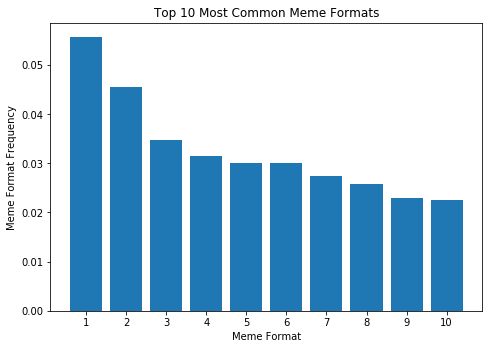

In [33]:
fig = plt.figure()
ax = fig.add_axes([0,0,1,1])

categoryx = ['1', '2', '3', '4', '5', '6', '7', '8', '9', '10']
#categoryx = ['ARTHROPOD-BORNE VIRAL DISEASES', 'MALIGNANT NEOPLASM', 'MALIGNANT NEOPLASM OF RESPIRATORY SYSTEM', '20', '15']
fractiony = [32141/575948, 26186/575948, 19971/575948, 18164/575948, 17325/575948, 17272/575948, 15850/575948, 14802/575948, 13194/575948, 12985/575948]  # calcaulate
ax.bar(categoryx,fractiony)

plt.title('Top 10 Most Common Meme Formats')
plt.ylabel("Meme Format Frequency")
plt.xlabel("Meme Format")
plt.show()
#  "total": 575948,

In [13]:
# making word embeddings for RNN
UNK = "<unk>"
WORDEMBSIZE = 64
W2V_WINDOW = 7
W2V_COUNT = 1
W2V_EPOCH=100

def makeVocab(text):
    vocab = set()
    for sentences in text:
        for word in sentences:
            vocab.add(word)
    return vocab

def makeEmbModel(data):
    docs = [[UNK]]
    docs.extend(data)
    model = Word2Vec(window=W2V_WINDOW, min_count=W2V_COUNT, size=WORDEMBSIZE)
    model.build_vocab(docs)
    model.train(docs, total_examples=len(docs), epochs=W2V_EPOCH)
    print(model)
    return model

def makeEmbeddings(data, model, vocab):
    vecData = []
    for sentence in data:
        wordEmbs = []
        for word in sentence:
            if word in vocab:
#                 print(type(model[word]))
#                 print(model[word])
                wordEmbs.append(model[word])
            else:
                wordEmbs.append(np.zeros(WORDEMBSIZE))
        wordEmbs = torch.FloatTensor(wordEmbs)
        vecData.append(wordEmbs)
    return vecData

In [35]:
# continue making word embeddings
X_words_train, X_words_test, y_train, y_test = train_test_split(X_words, y, test_size=0.2, random_state=42)
vocab = makeVocab(X_words_train)
emb_model = makeEmbModel(X_words_train)
vocab = set(list(emb_model.wv.vocab.keys()))
X_train = makeEmbeddings(X_words_train, emb_model, vocab)
X_test = makeEmbeddings(X_words_test, emb_model, vocab)

print(X_words_train[0])
print(X_train[0])
print(y_train[0])

Word2Vec(vocab=17434, size=64, alpha=0.025)


/Users/kathy908000/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:32: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).


['belt', 'ww3', 'me']
tensor([[ 0.6852,  0.6181, -0.2568,  0.3250, -1.3172,  0.2496,  1.3115, -0.6972,
         -0.4141,  0.5243, -1.7616,  0.2553, -0.6701,  1.6186,  0.3276,  0.8346,
         -0.9366, -1.9377,  2.3634, -0.3053, -0.5340,  0.5596, -0.2272, -2.2908,
         -0.4170, -2.3659,  1.3769,  1.5357,  0.0102,  0.9227, -0.6851,  0.5771,
          2.0212,  0.8715,  0.4708, -0.4264,  3.3132,  0.4821, -0.6754, -1.1405,
          0.4538,  0.7242, -0.1118, -1.6256, -0.1296, -0.7650, -0.0934, -1.6463,
         -1.5256, -0.5843,  0.8034, -0.2167,  0.0690,  0.4020,  0.6104, -0.5651,
          0.3560, -0.5685,  0.4722, -1.9669,  1.1146, -1.0029, -1.3665,  1.2768],
        [-0.4765,  0.5289,  1.1611, -0.8996,  1.0058,  0.0714,  0.8915,  0.4927,
          0.8312,  0.5370, -0.6288,  0.9239, -0.9126,  0.2235, -0.4757,  0.7656,
          0.2865, -1.8399,  1.2815,  0.3319, -0.1546, -1.0035,  0.0527,  0.0968,
         -0.2781, -0.6563, -0.1969,  0.5809, -0.7759,  1.6513, -1.8309,  0.1211,
     

In [36]:
# RNN building to predict result
import torch
import torch.nn as nn
import torch.optim as optim
import random
from tqdm.notebook import tqdm
from sklearn.utils import shuffle
import matplotlib.pyplot as plt

In [37]:
# RNN model
class RNN(nn.Module):
    def __init__(self, input_dim, h, output_dim = 5):
        super(RNN, self).__init__()
        self.rnn = nn.RNN(input_dim, h, dropout=0.2)
        self.finalLayer = nn.Linear(h, output_dim)
        self.input_dim = input_dim
        self.hidden_dim = h
        self.output_dim =  output_dim
#         self.word_embeddings = nn.Embedding(vocab_size, input_dim)
        self.softmax = nn.LogSoftmax()
        self.loss = nn.NLLLoss()
    
    def compute_loss(self, predicted_vector, gold_label):
        return self.loss(predicted_vector, gold_label)
    
    def forward(self, inputs):
        out, hidden = self.rnn(inputs)
        hidden = hidden.contiguous().view(-1,self.hidden_dim)
        predicted_vector = self.softmax(self.finalLayer(hidden))
        return predicted_vector

In [38]:
# running epochs for training and validation
HIDDEN_DIM = 128
EPOCHS = 30

model = RNN(WORDEMBSIZE, HIDDEN_DIM, 5)
optimizer = optim.SGD(model.parameters(),lr=0.0005, momentum=0.9)
train_loss = []
test_loss = []
for epoch in range(EPOCHS):
    print("\n\n-------------")
    print("EPOCH: {}".format(epoch + 1))
    running_loss = 0.0
    model.train()
    optimizer.zero_grad()
    print("Training started for epoch:{}".format(epoch + 1))
    X_train, y_train = shuffle(X_train, y_train)
    start_time = time.time()
    correct = total = 0
    minibatch_size = 16
    N = len(y_train)
    for minibatch_idx in tqdm(range(N // minibatch_size)):
        optimizer.zero_grad()
        loss = None
        for idx in range(minibatch_size):
            text = X_train[minibatch_idx * minibatch_size + idx]
            text = torch.unsqueeze(text, 1)
            labelIdx = y_train[minibatch_idx * minibatch_size + idx]
            log_probs = model(text)
            text_loss = model.compute_loss(log_probs.view(1,-1), torch.tensor([labelIdx]))
            running_loss += text_loss
            if loss is None:
                loss = text_loss
            else:
                loss += text_loss
            pred_label = torch.argmax(log_probs)
            correct += int(pred_label == labelIdx)
            total += 1
        loss = loss / minibatch_size
        loss.backward()
        optimizer.step()
    train_loss.append(running_loss / N)
    print("Training completed for epoch: {}".format(epoch + 1))
    print("Time for train: {}".format(time.time() - start_time))
    print("Accuracy: {}".format(correct / total))
    
    #validation
    running_loss = 0.0
    model.eval()
    optimizer.zero_grad()
    print("Validation started for epoch:{}".format(epoch + 1))
    X_test, y_test = shuffle(X_test, y_test)
    start_time = time.time()
    correct = total = 0
    minibatch_size = 16
    N = len(y_test)
    for minibatch_idx in tqdm(range(N // minibatch_size)):
        optimizer.zero_grad()
        for idx in range(minibatch_size):
            text = X_test[minibatch_idx * minibatch_size + idx]
            text = torch.unsqueeze(text, 1)
            labelIdx = y_test[minibatch_idx * minibatch_size + idx]
            log_probs = model(text)
            text_loss = model.compute_loss(log_probs.view(1,-1), torch.tensor([labelIdx]))
            running_loss += text_loss
            pred_label = torch.argmax(log_probs)
            correct += int(pred_label == labelIdx)
            total += 1
    test_loss.append(running_loss / N)
    print("Validation completed for epoch: {}".format(epoch + 1))
    print("Time for validation: {}".format(time.time() - start_time))
    print("Accuracy: {}".format(correct / total))

plt.plot(train_loss, label='train loss')
plt.plot(test_loss, label='test loss')
plt.legend()
plt.show()



-------------
EPOCH: 1


/Users/kathy908000/anaconda3/lib/python3.7/site-packages/torch/nn/modules/rnn.py:46: UserWarning: dropout option adds dropout after all but last recurrent layer, so non-zero dropout expects num_layers greater than 1, but got dropout=0.2 and num_layers=1
  "num_layers={}".format(dropout, num_layers))


Training started for epoch:1


/Users/kathy908000/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:20: UserWarning: Implicit dimension choice for log_softmax has been deprecated. Change the call to include dim=X as an argument.


RuntimeError: input must have 3 dimensions, got 2

In [ ]:
selected_memes = [
    'Woman-Yelling-At-Cat.json',  #4604
    'Left-Exit-12-Off-Ramp.json', #4319
    'Surprised-Pikachu.json',    #3507
    'Is-This-A-Pigeon.json',   #3507
    'Drake-Hotline-Bling.json',  #2690
    'Blank-Nut-Button.json', #5714
    'One-Does-Not-Simply.json',# 26186 #only use 5000 to match button meme number
    'Change-My-Mind.json', #8563
    'Roll-Safe-Think-About-It.json', #6948
    'Leonardo-Dicaprio-Cheers.json' #8377
]